# EDA_StockPrediction_NASDAQ_Comp

In [1]:
import pandas as pd

import seaborn as sns
import numpy as np
import random
import re
import matplotlib.pyplot as plt
from datetime import date

plt.rcParams['figure.figsize'] = (20, 12) 
plt.rcParams.update({'font.size': 22})

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [2]:
pd.set_option('display.max_columns', None)

In [3]:
df=pd.read_csv("Cleaned_Data_Stock_Prediction.csv")

In [4]:
df.head()

,Date,NASDAQ_Comp_Open,NASDAQ_Comp_High,NASDAQ_Comp_Low,NASDAQ_Comp_Close,NASDAQ_Comp_Adj Close,NASDAQ_Comp_Volume,NASDAQ_Comp_%_Daily_Return,NASDAQ_Comp_Yesterday_Price_Change,NASDAQ_Comp_%_Daily_Change,NASDAQ_Comp_Daily_Change,NASDAQ_Comp_tmr_Change,Dow_Jones_Open,Dow_Jones_Close,Dow_Jones_High,Dow_Jones_Low,Dow_Jones_Volume,Dow_Jones_%_Daily_Return,Dow_Jones_Yesterday_Price_Change,Dow_Jones_%_Daily_Change,Dow_Jones_Daily_Change,Dow_Jones_tmr_Change,S_P_500_Open,S_P_500_High,S_P_500_Low,S_P_500_Close,S_P_500_Adj Close,S_P_500_Volume,S_P_500_%_Daily_Return,S_P_500_Yesterday_Price_Change,S_P_500_%_Daily_Change,S_P_500_Daily_Change,S_P_500_tmr_Change,AAPL_Open,AAPL_High,AAPL_Low,AAPL_Close,AAPL_Adj Close,AAPL_Volume,AAPL_%_Daily_Return,AAPL_Yesterday_Price_Change,AAPL_%_Daily_Change,AAPL_Daily_Change,AAPL_tmr_Change,MSFT_Open,MSFT_High,MSFT_Low,MSFT_Close,MSFT_Adj Close,MSFT_Volume,MSFT_%_Daily_Return,MSFT_Yesterday_Price_Change,MSFT_%_Daily_Change,MSFT_Daily_Change,MSFT_tmr_Change,AMZN_Open,AMZN_High,AMZN_Low,AMZN_Close,AMZN_Adj Close,AMZN_Volume,AMZN_%_Daily_Return,AMZN_Yesterday_Price_Change,AMZN_%_Daily_Change,AMZN_Daily_Change,AMZN_tmr_Change,FB_Open,FB_High,FB_Low,FB_Close,FB_Adj Close,FB_Volume,FB_%_Daily_Return,FB_Yesterday_Price_Change,FB_%_Daily_Change,FB_Daily_Change,FB_tmr_Change,GOOG_Open,GOOG_High,GOOG_Low,GOOG_Close,GOOG_Adj Close,GOOG_Volume,GOOG_%_Daily_Return,GOOG_Yesterday_Price_Change,GOOG_%_Daily_Change,GOOG_Daily_Change,GOOG_tmr_Change,GOOGL_Open,GOOGL_High,GOOGL_Low,GOOGL_Close,GOOGL_Adj Close,GOOGL_Volume,GOOGL_%_Daily_Return,GOOGL_Yesterday_Price_Change,GOOGL_%_Daily_Change,GOOGL_Daily_Change,GOOGL_tmr_Change,TSLA_Open,TSLA_High,TSLA_Low,TSLA_Close,TSLA_Adj Close,TSLA_Volume,TSLA_%_Daily_Return,TSLA_Yesterday_Price_Change,TSLA_%_Daily_Change,TSLA_Daily_Change,TSLA_tmr_Change,NVDA_Open,NVDA_High,NVDA_Low,NVDA_Close,NVDA_Adj Close,NVDA_Volume,NVDA_%_Daily_Return,NVDA_Yesterday_Price_Change,NVDA_%_Daily_Change,NVDA_Daily_Change,NVDA_tmr_Change,ASML_Open,ASML_High,ASML_Low,ASML_Close,ASML_Adj Close,ASML_Volume,ASML_%_Daily_Return,ASML_Yesterday_Price_Change,ASML_%_Daily_Change,ASML_Daily_Change,ASML_tmr_Change,INTC_Open,INTC_High,INTC_Low,INTC_Close,INTC_Adj Close,INTC_Volume,INTC_%_Daily_Return,INTC_Yesterday_Price_Change,INTC_%_Daily_Change,INTC_Daily_Change,INTC_tmr_Change,CMCSA_Open,CMCSA_High,CMCSA_Low,CMCSA_Close,CMCSA_Adj Close,CMCSA_Volume,CMCSA_%_Daily_Return,CMCSA_Yesterday_Price_Change,CMCSA_%_Daily_Change,CMCSA_Daily_Change,CMCSA_tmr_Change,NFLX_Open,NFLX_High,NFLX_Low,NFLX_Close,NFLX_Adj Close,NFLX_Volume,NFLX_%_Daily_Return,NFLX_Yesterday_Price_Change,NFLX_%_Daily_Change,NFLX_Daily_Change,NFLX_tmr_Change,ADBE_Open,ADBE_High,ADBE_Low,ADBE_Close,ADBE_Adj Close,ADBE_Volume,ADBE_%_Daily_Return,ADBE_Yesterday_Price_Change,ADBE_%_Daily_Change,ADBE_Daily_Change,ADBE_tmr_Change,CSCO_Open,CSCO_High,CSCO_Low,CSCO_Close,CSCO_Adj Close,CSCO_Volume,CSCO_%_Daily_Return,CSCO_Yesterday_Price_Change,CSCO_%_Daily_Change,CSCO_Daily_Change,CSCO_tmr_Change,PEP_Open,PEP_High,PEP_Low,PEP_Close,PEP_Adj Close,PEP_Volume,PEP_%_Daily_Return,PEP_Yesterday_Price_Change,PEP_%_Daily_Change,PEP_Daily_Change,PEP_tmr_Change,AVGO_Open,AVGO_High,AVGO_Low,AVGO_Close,AVGO_Adj Close,AVGO_Volume,AVGO_%_Daily_Return,AVGO_Yesterday_Price_Change,AVGO_%_Daily_Change,AVGO_Daily_Change,AVGO_tmr_Change,TXN_Open,TXN_High,TXN_Low,TXN_Close,TXN_Adj Close,TXN_Volume,TXN_%_Daily_Return,TXN_Yesterday_Price_Change,TXN_%_Daily_Change,TXN_Daily_Change,TXN_tmr_Change,TMUS_Open,TMUS_High,TMUS_Low,TMUS_Close,TMUS_Adj Close,TMUS_Volume,TMUS_%_Daily_Return,TMUS_Yesterday_Price_Change,TMUS_%_Daily_Change,TMUS_Daily_Change,TMUS_tmr_Change,_13_Week_Treasury_Bill_Open,_13_Week_Treasury_Bill_High,_13_Week_Treasury_Bill_Low,_13_Week_Treasury_Bill_Close,_13_Week_Treasury_Bill_Adj Close,_13_Week_Treasury_Bill_%_Daily_Return,_13_Week_Treasury_Bill_Yesterday_Price_Change,_13_Week_Treasury_Bill_%_Daily_Change,_13_Week_Treasury_Bill_Daily_Change,_13_Week_Treasury_B

In [5]:
df.Date=pd.to_datetime(df.Date)
df['month_year'] = df['Date'].dt.to_period('M')

In [6]:
#print(df.columns.tolist())

In [7]:
#df.info(verbose=True)

# General View

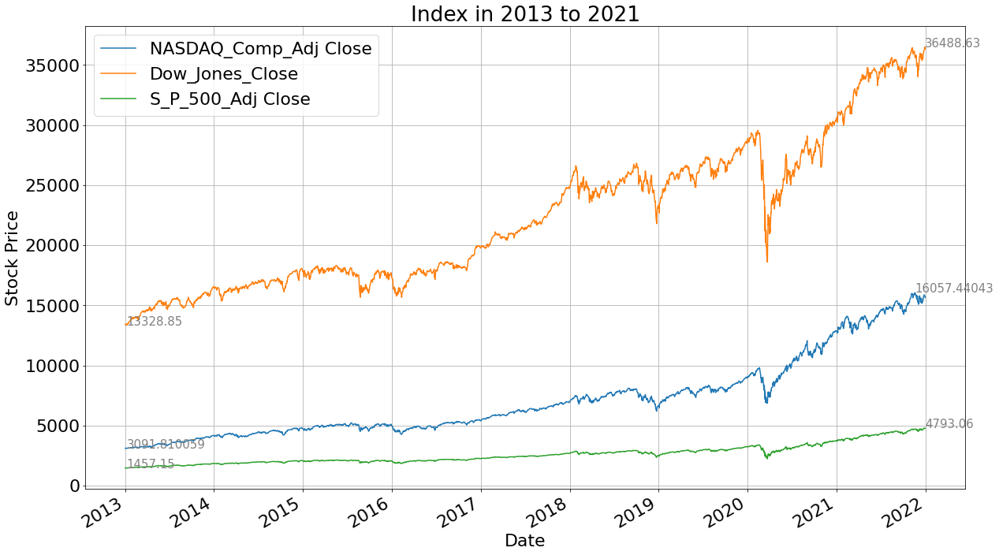

In [8]:
# Index

ax=df.groupby('Date')[['NASDAQ_Comp_Adj Close','Dow_Jones_Close','S_P_500_Adj Close']].mean().plot()
plt.grid()
style = dict(size=15, color='gray')
ax.text(df.Date[df['NASDAQ_Comp_Adj Close']==df['NASDAQ_Comp_Adj Close'].max()], df['NASDAQ_Comp_Adj Close'].max(), df['NASDAQ_Comp_Adj Close'].max(), **style)
ax.text(df.Date[df['NASDAQ_Comp_Adj Close']==df['NASDAQ_Comp_Adj Close'].min()], df['NASDAQ_Comp_Adj Close'].min(), df['NASDAQ_Comp_Adj Close'].min(), **style)
ax.text(df.Date[df['Dow_Jones_Close']==df['Dow_Jones_Close'].max()], df['Dow_Jones_Close'].max(), df['Dow_Jones_Close'].max(), **style)
ax.text(df.Date[df['Dow_Jones_Close']==df['Dow_Jones_Close'].min()], df['Dow_Jones_Close'].min(), df['Dow_Jones_Close'].min(), **style)
ax.text(df.Date[df['S_P_500_Adj Close']==df['S_P_500_Adj Close'].max()], df['S_P_500_Adj Close'].max(), df['S_P_500_Adj Close'].max(), **style)
ax.text(df.Date[df['S_P_500_Adj Close']==df['S_P_500_Adj Close'].min()], df['S_P_500_Adj Close'].min(), df['S_P_500_Adj Close'].min(), **style)


plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.title('Index in 2013 to 2021')
plt.savefig("Index in 2013 to 2021", bbox_inches='tight')
plt.show()

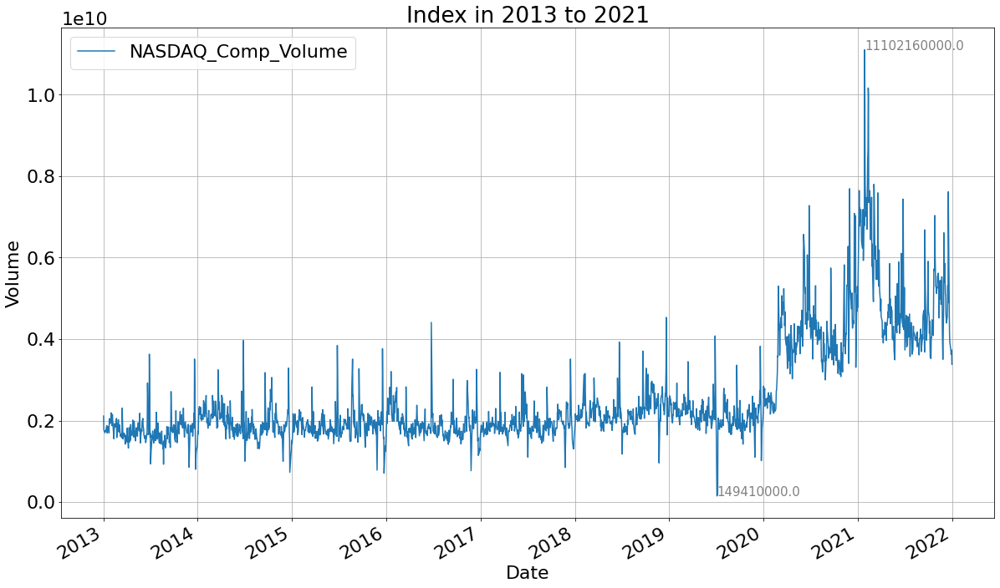

In [9]:
# Index

ax=df.groupby('Date')[['NASDAQ_Comp_Volume']].mean().plot()
plt.grid()
style = dict(size=15, color='gray')
ax.text(df.Date[df['NASDAQ_Comp_Volume']==df['NASDAQ_Comp_Volume'].max()], df['NASDAQ_Comp_Volume'].max(), df['NASDAQ_Comp_Volume'].max(), **style)
ax.text(df.Date[df['NASDAQ_Comp_Volume']==df['NASDAQ_Comp_Volume'].min()], df['NASDAQ_Comp_Volume'].min(), df['NASDAQ_Comp_Volume'].min(), **style)


plt.xlabel('Date')
plt.ylabel('Volume')
plt.title('Index in 2013 to 2021')
plt.savefig("Volume of NASDAQ in 2013 to 2021", bbox_inches='tight')
plt.show()




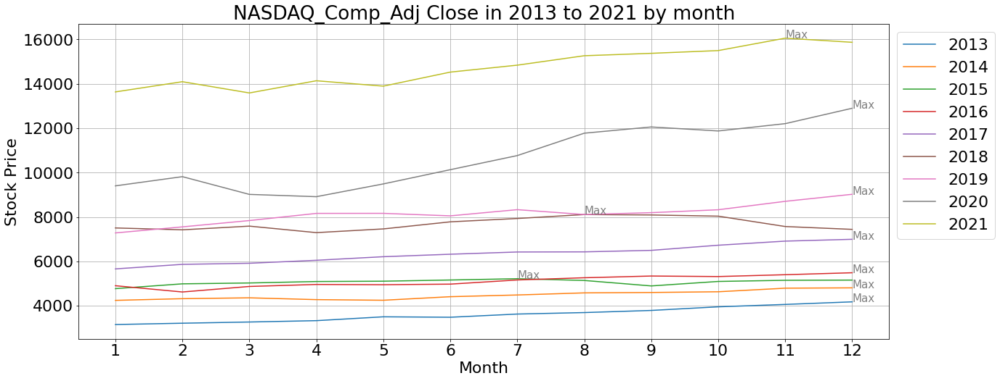

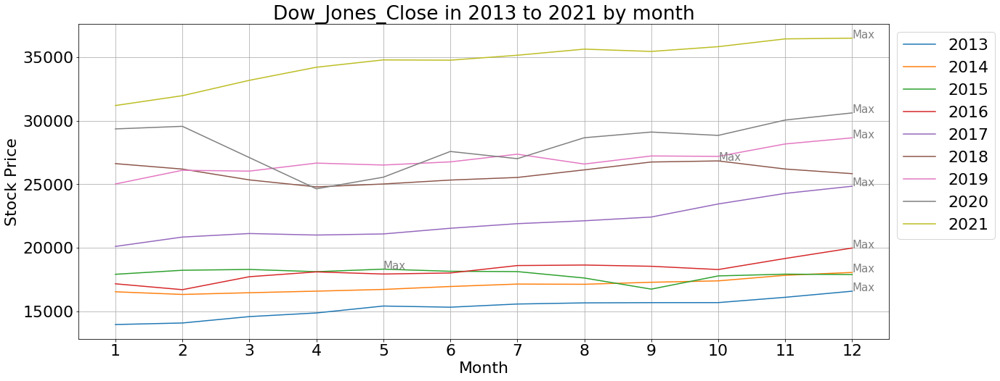

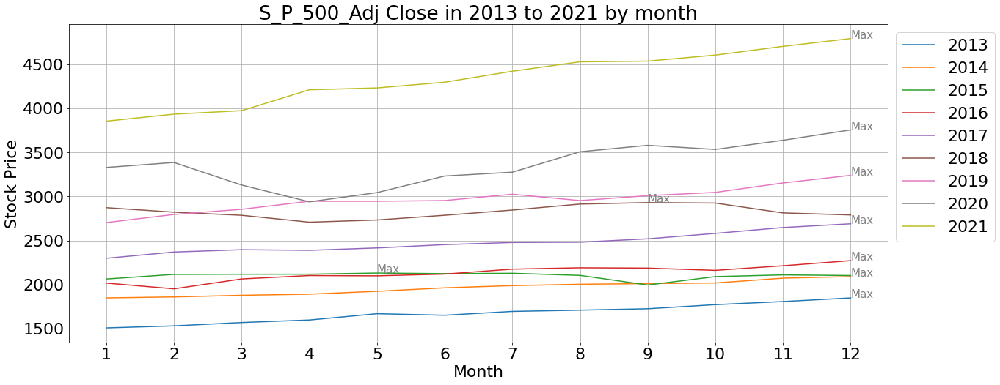

In [10]:
# NASDAQ_Comp by month
year_an=[i for i in range(2013,2022)]
Index_adj_list=['NASDAQ_Comp_Adj Close','Dow_Jones_Close','S_P_500_Adj Close']

for i in Index_adj_list:
    for j in year_an:
        ax=df[df['Year']==j].groupby('Month')[i].max().plot(figsize=(20, 8))
        ax.text(df[df['Year']==j].groupby('Month')[i].max().idxmax(), df[df['Year']==j].groupby('Month')[i].max().max(), 'Max', **style)
       
    plt.legend(year_an,bbox_to_anchor=(1, 1))
    plt.grid()
    plt.xticks(df.Month.unique())
    plt.xlabel('Month')
    plt.ylabel('Stock Price')
    plt.title('{} in 2013 to 2021 by month'.format(i))
    plt.savefig('{} in 2013 to 2021 by month'.format(i), bbox_inches='tight')
    plt.show()





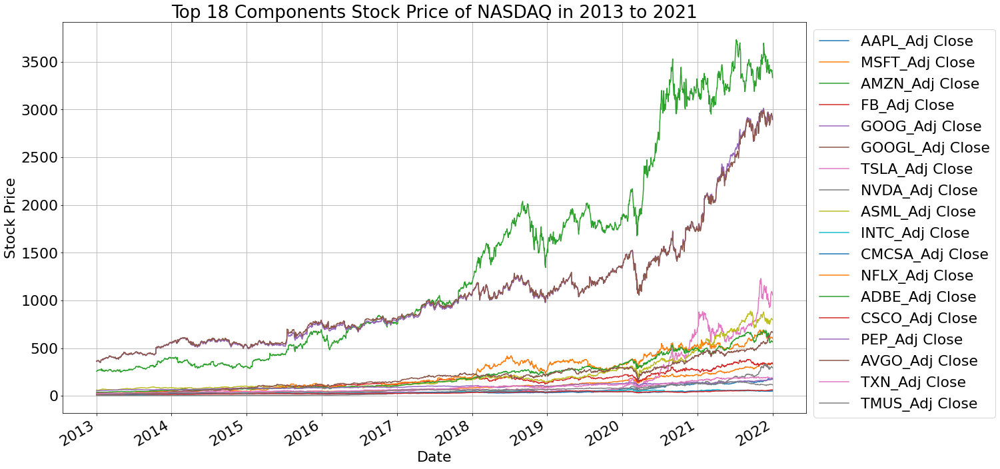

In [11]:
# Top 18 Components of NASDAQ (from Top 20 Components of NASDAQ, removed PYPL and PDD )
Stock=['AAPL','MSFT','AMZN','FB','GOOG','GOOGL','TSLA','NVDA','ASML','INTC','CMCSA','NFLX','ADBE','CSCO','PEP','AVGO','TXN','TMUS']
Stock_adj_list=[i+'_Adj Close' for i in Stock]  
ax=df.groupby('Date')[Stock_adj_list].mean().plot()
plt.grid()
style = dict(size=15, color='gray') 
plt.legend(bbox_to_anchor=(1, 1))
plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.title('Top 18 Components Stock Price of NASDAQ in 2013 to 2021')
plt.savefig('Top 18 Components Stock Price of NASDAQ in 2013 to 2021', bbox_inches='tight')
plt.show()

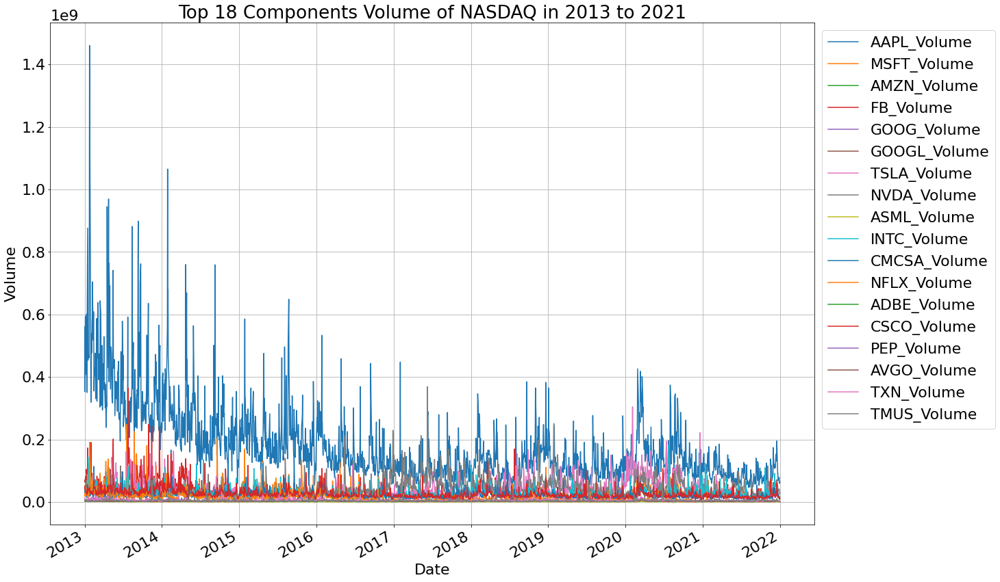

In [12]:
# Top 18 Components of NASDAQ (from Top 20 Components of NASDAQ, removed PYPL and PDD )
Stock=['AAPL','MSFT','AMZN','FB','GOOG','GOOGL','TSLA','NVDA','ASML','INTC','CMCSA','NFLX','ADBE','CSCO','PEP','AVGO','TXN','TMUS']

Stock_vol_list=[i+'_Volume' for i in Stock]
    
ax=df.groupby('Date')[Stock_vol_list].mean().plot(figsize=(20, 15))
plt.grid()
style = dict(size=15, color='gray') 
plt.legend(bbox_to_anchor=(1, 1))
plt.xlabel('Date')
plt.ylabel('Volume')
plt.title('Top 18 Components Volume of NASDAQ in 2013 to 2021')
plt.savefig('Top 18 Components Volume of NASDAQ in 2013 to 2021', bbox_inches='tight')
plt.show()

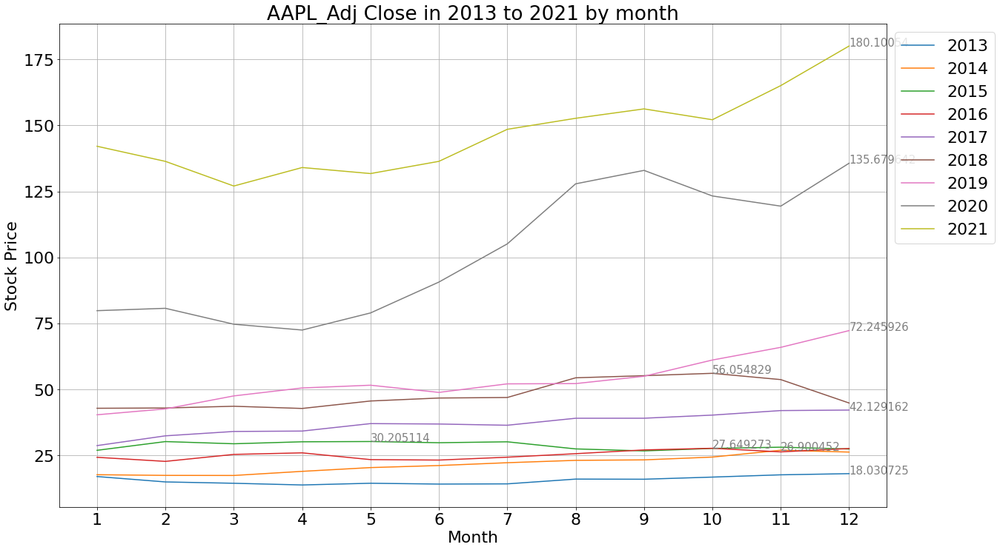

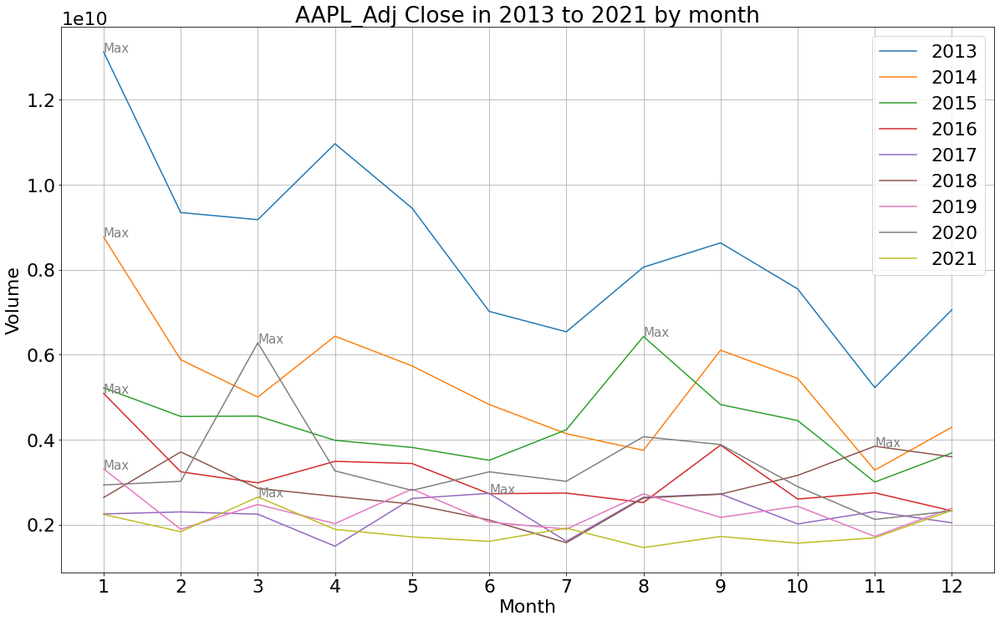

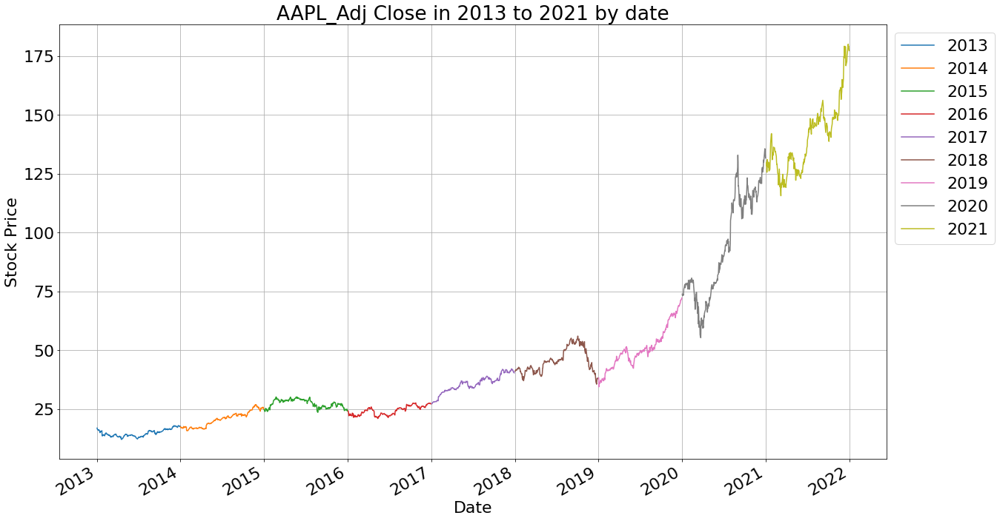

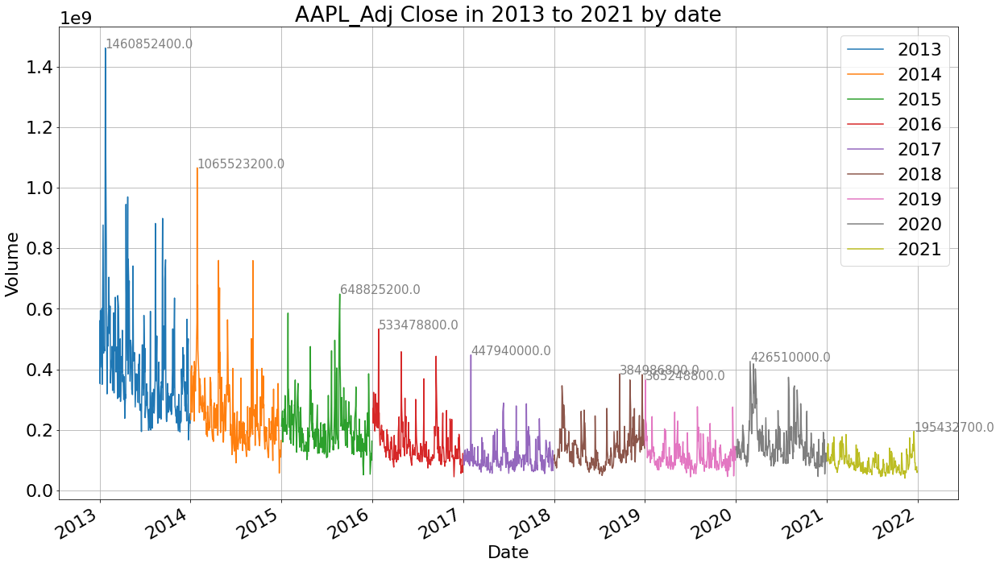

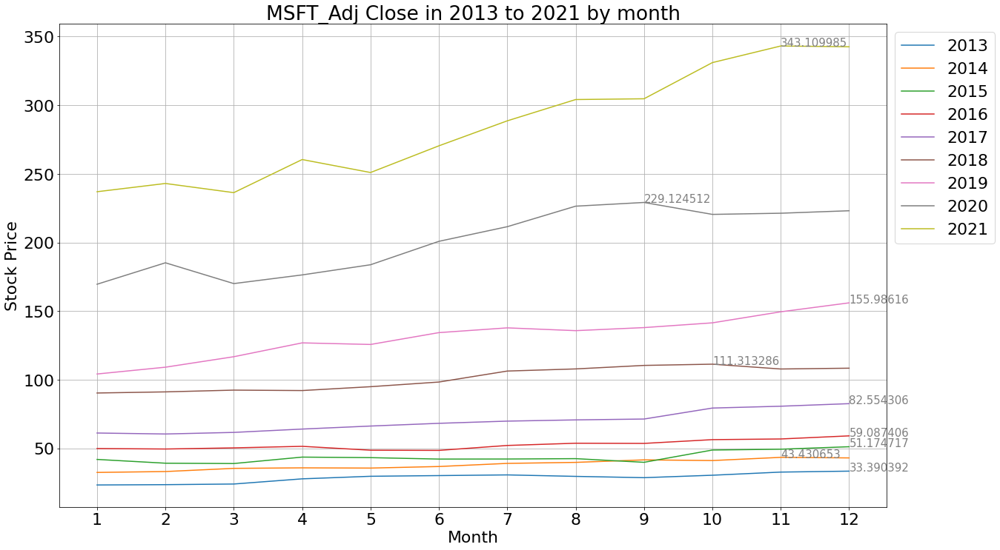

...

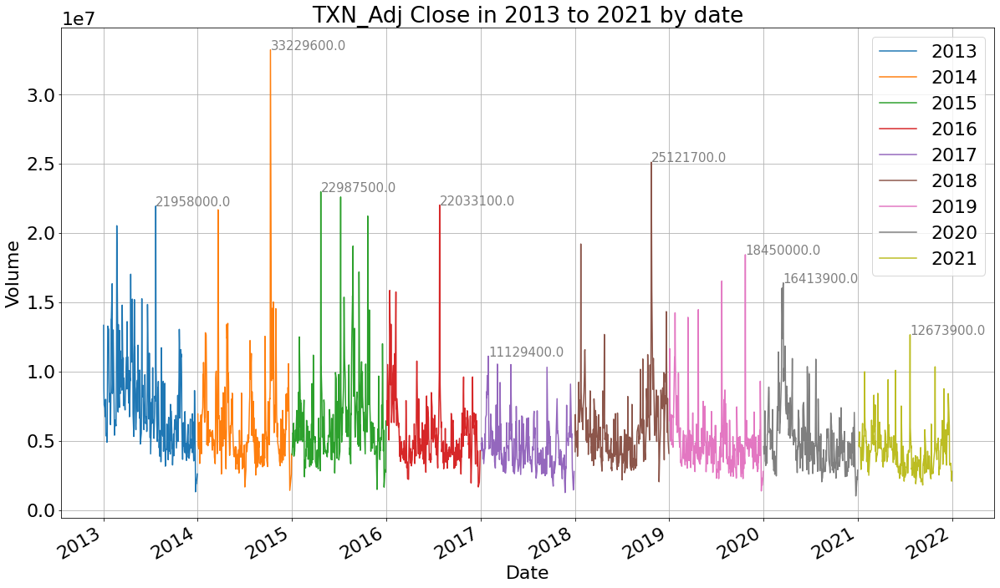

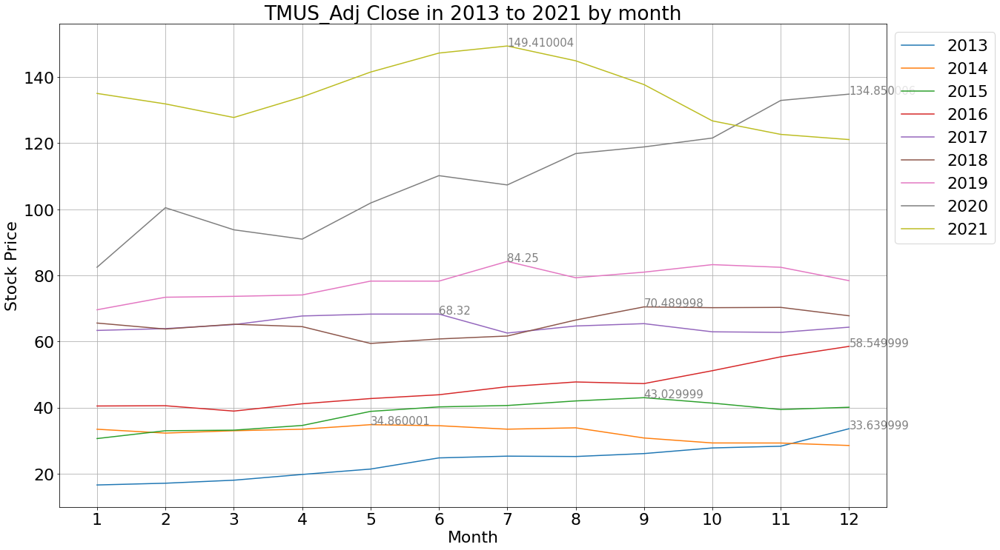

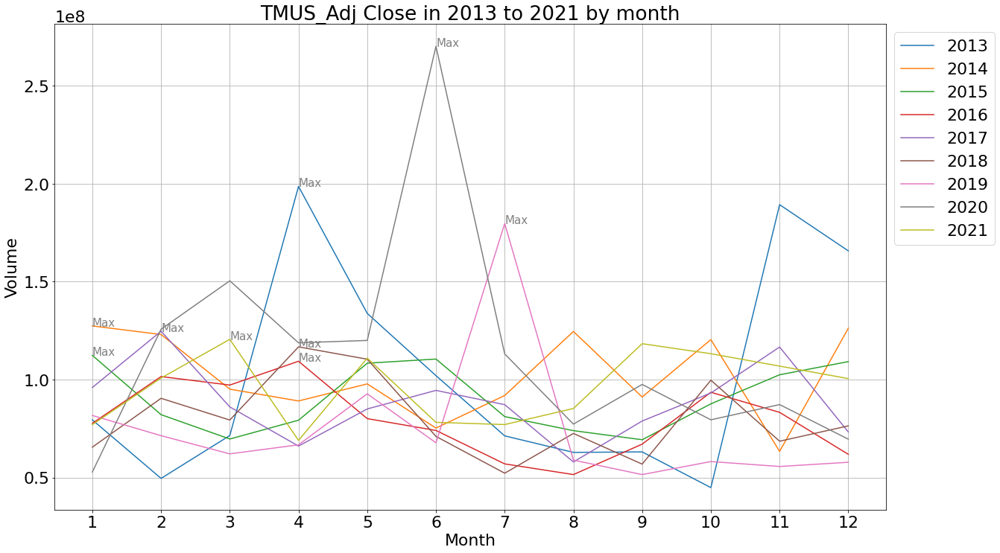

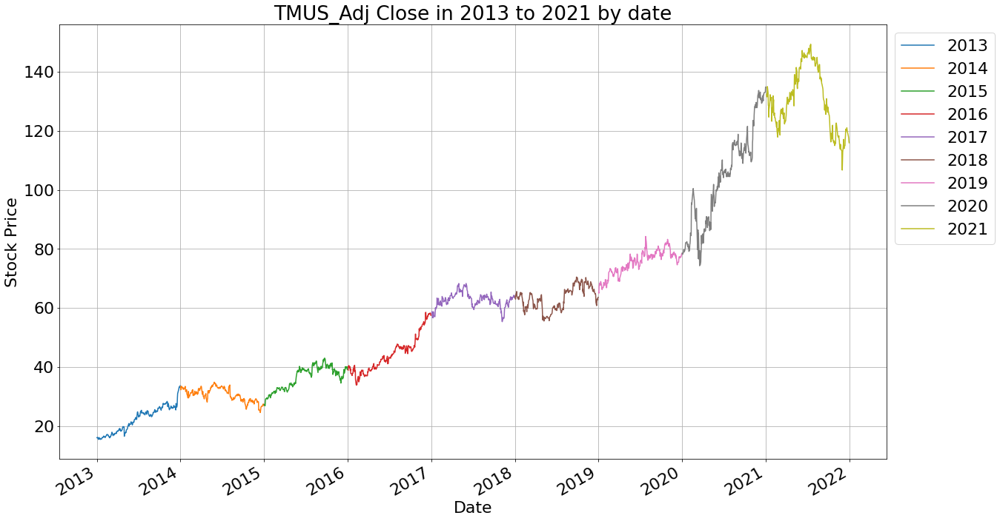

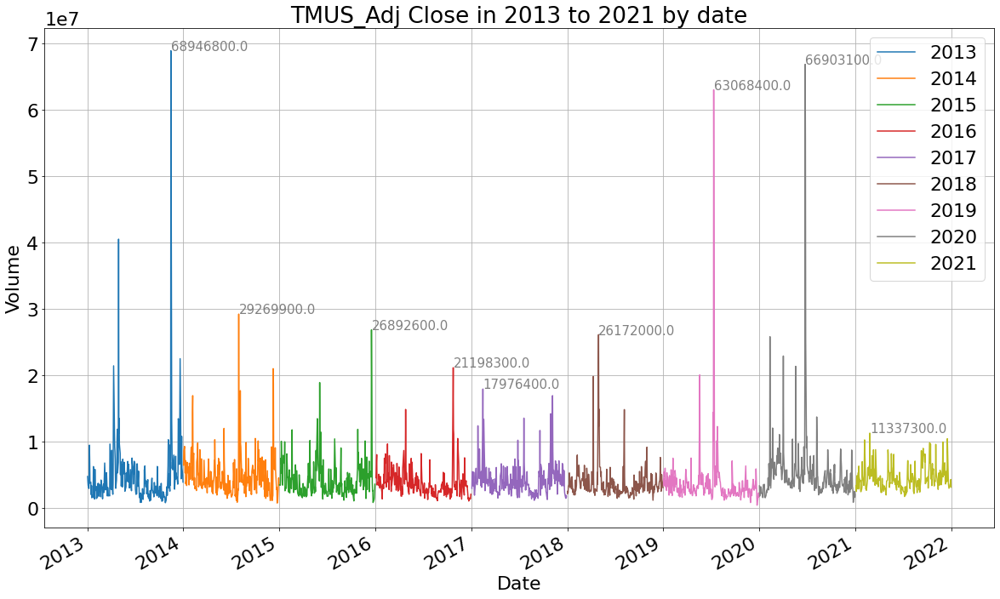

In [13]:

for i,k in zip(Stock_adj_list,Stock_vol_list):
    for j in year_an:
        ax=df[df['Year']==j].groupby('Month')[i].max().plot()
        ax.text(df[df['Year']==j].groupby('Month')[i].max().idxmax(), df[df['Year']==j].groupby('Month')[i].max().max(), df[df['Year']==j].groupby('Month')[i].max().max(), **style)
       
    plt.legend(year_an,bbox_to_anchor=(1, 1))
    plt.grid()
    plt.xticks(df.Month.unique())
    plt.xlabel('Month')
    plt.ylabel('Stock Price')
    plt.title('{} in 2013 to 2021 by month'.format(i))
    plt.savefig('{} in 2013 to 2021 by month'.format(i), bbox_inches='tight')
    plt.show()
    
    for j in year_an:
        ax=df[df['Year']==j].groupby('Month')[k].sum().plot()
        ax.text(df[df['Year']==j].groupby('Month')[k].sum().idxmax(), df[df['Year']==j].groupby('Month')[k].sum().max(), 'Max', **style)
       
    plt.legend(year_an,bbox_to_anchor=(1, 1))
    plt.grid()
    plt.xticks(df.Month.unique())
    plt.xlabel('Month')
    plt.ylabel('Volume')
    plt.title('{} in 2013 to 2021 by month'.format(i))
    plt.savefig('{} in 2013 to 2021 by month'.format(i), bbox_inches='tight')
    plt.show()
    
    for j in year_an:
        ax=df[df['Year']==j].groupby('Date')[i].max().plot()
        
    plt.legend(year_an,bbox_to_anchor=(1, 1))
    plt.grid()
    plt.xlabel('Date')
    plt.ylabel('Stock Price')
    plt.title('{} in 2013 to 2021 by date'.format(i))
    plt.savefig('{} in 2013 to 2021 by date'.format(i), bbox_inches='tight')
    plt.show()
    
    for j in year_an:
        ax=df[df['Year']==j].groupby('Date')[k].sum().plot()
        ax.text(df[df['Year']==j].groupby('Date')[k].sum().idxmax(), df[df['Year']==j].groupby('Date')[k].sum().max(), df[df['Year']==j].groupby('Date')[k].sum().max(), **style)
       
    plt.legend(year_an,bbox_to_anchor=(1, 1))
    plt.grid()
    plt.xlabel('Date')
    plt.ylabel('Volume')
    plt.title('{} in 2013 to 2021 by date'.format(i))
    plt.savefig('{} in 2013 to 2021 by date'.format(i), bbox_inches='tight')
    plt.show()
    

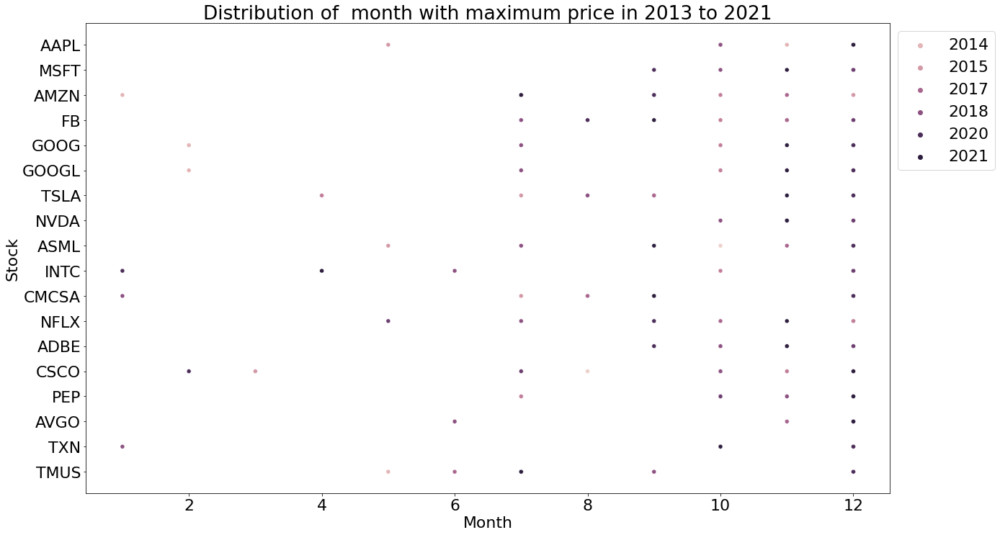

In [14]:

dict_max_month_Stock={'Stock':[],'Month':[],'Year':[]}

for i in range(len(Stock_adj_list)): 
    for j in year_an:
        dict_max_month_Stock['Year'].append(j)
        dict_max_month_Stock['Stock'].append(Stock[i])
        dict_max_month_Stock['Month'].append(df[df['Year']==j].groupby('Month')[Stock_adj_list[i]].max().idxmax())
        
df_max_month=pd.DataFrame(dict_max_month_Stock)

df_max_month

sns.scatterplot(data=df_max_month, x="Month", y="Stock",hue='Year')
plt.legend(bbox_to_anchor=(1, 1))
plt.title('Distribution of  month with maximum price in 2013 to 2021')
plt.savefig('Distribution of  month with maximum price in 2013 to 2021', bbox_inches='tight')
plt.show()

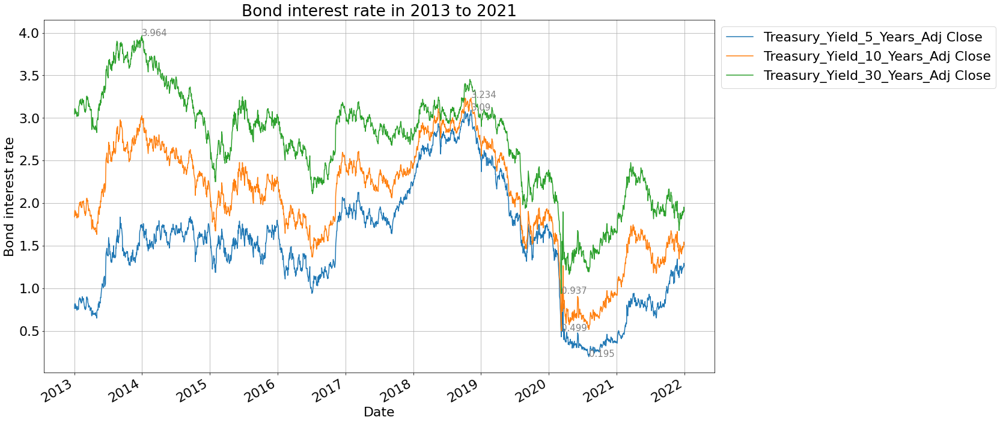

In [15]:
# Bond

ax=df.groupby('Date')[['Treasury_Yield_5_Years_Adj Close','Treasury_Yield_10_Years_Adj Close','Treasury_Yield_30_Years_Adj Close']].mean().plot()
plt.grid()
style = dict(size=15, color='gray')
ax.text(df.Date[df['Treasury_Yield_5_Years_Adj Close']==df['Treasury_Yield_5_Years_Adj Close'].max()], df['Treasury_Yield_5_Years_Adj Close'].max(), df['Treasury_Yield_5_Years_Adj Close'].max(), **style)
ax.text(df.Date[df['Treasury_Yield_5_Years_Adj Close']==df['Treasury_Yield_5_Years_Adj Close'].min()], df['Treasury_Yield_5_Years_Adj Close'].min(), df['Treasury_Yield_5_Years_Adj Close'].min(), **style)
ax.text(df.Date[df['Treasury_Yield_10_Years_Adj Close']==df['Treasury_Yield_10_Years_Adj Close'].max()], df['Treasury_Yield_10_Years_Adj Close'].max(), df['Treasury_Yield_10_Years_Adj Close'].max(), **style)
ax.text(df.Date[df['Treasury_Yield_10_Years_Adj Close']==df['Treasury_Yield_10_Years_Adj Close'].min()], df['Treasury_Yield_10_Years_Adj Close'].min(), df['Treasury_Yield_10_Years_Adj Close'].min(), **style)
ax.text(df.Date[df['Treasury_Yield_30_Years_Adj Close']==df['Treasury_Yield_30_Years_Adj Close'].max()], df['Treasury_Yield_30_Years_Adj Close'].max(), df['Treasury_Yield_30_Years_Adj Close'].max(), **style)
ax.text(df.Date[df['Treasury_Yield_30_Years_Adj Close']==df['Treasury_Yield_30_Years_Adj Close'].min()], df['Treasury_Yield_30_Years_Adj Close'].min(), df['Treasury_Yield_30_Years_Adj Close'].min(), **style)

plt.legend(bbox_to_anchor=(1, 1))
plt.xlabel('Date')
plt.ylabel('Bond interest rate')
plt.title('Bond interest rate in 2013 to 2021')
plt.savefig('Bond interest rate in 2013 to 2021', bbox_inches='tight')
plt.show()



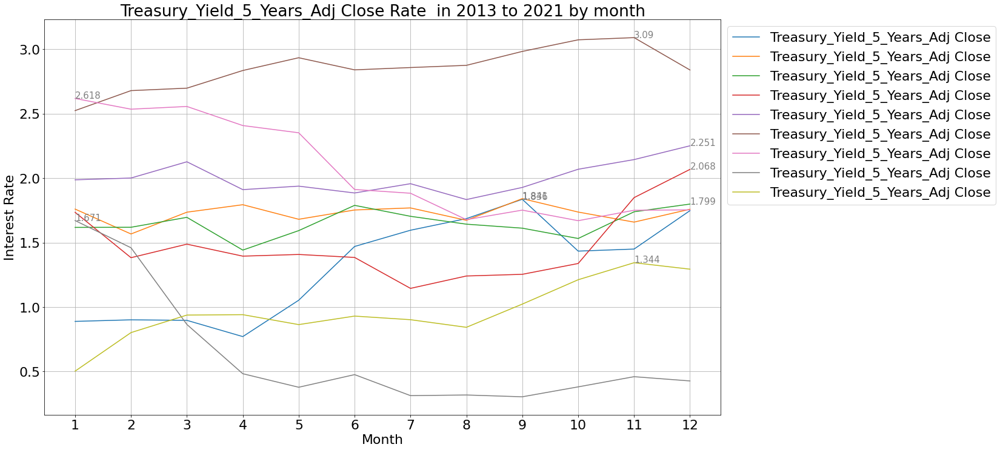

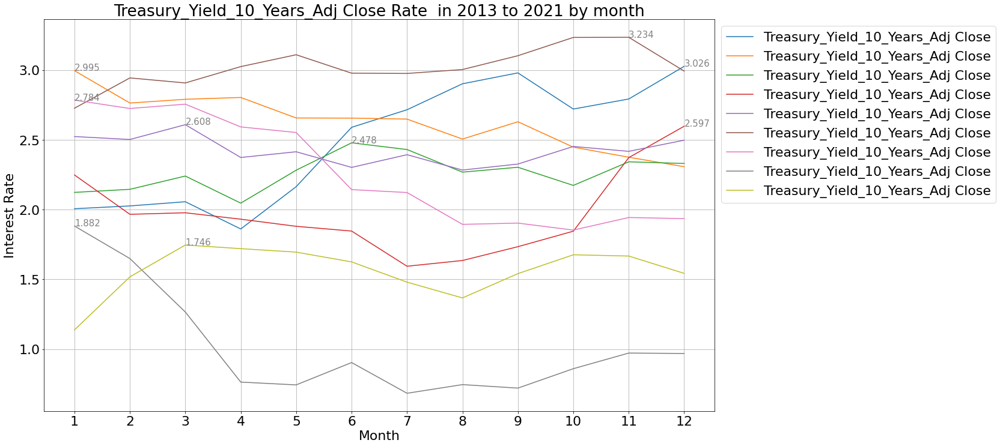

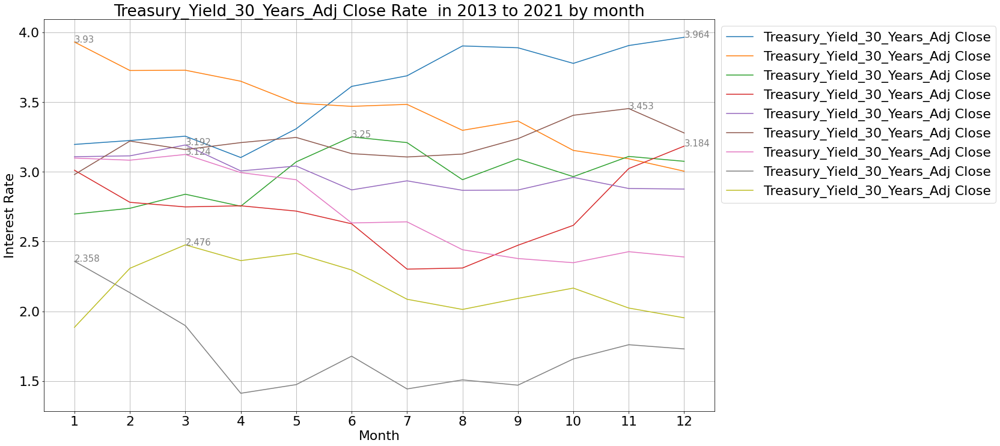

In [16]:
Bond=['Treasury_Yield_5_Years','Treasury_Yield_10_Years','Treasury_Yield_30_Years']
Bond_adj_list=[i+'_Adj Close' for i in Bond]
for i in Bond_adj_list:
    for j in year_an:
        ax=df[df['Year']==j].groupby('Month')[i].max().plot()
        ax.text(df[df['Year']==j].groupby('Month')[i].max().idxmax(), df[df['Year']==j].groupby('Month')[i].max().max(), df[df['Year']==j].groupby('Month')[i].max().max(), **style)

    plt.legend(bbox_to_anchor=(1, 1))
    plt.grid()
    plt.xticks(df.Month.unique())
    plt.xlabel('Month')
    plt.ylabel('Interest Rate')
    plt.title('{} Rate  in 2013 to 2021 by month'.format(i))
    plt.savefig('{} Rate  in 2013 to 2021 by month'.format(i), bbox_inches='tight')
    plt.show()




C:\Users\jacksuen\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:677: UserWarning: The handle <matplotlib.lines.Line2D object at 0x000001E52B56C6A0> has a label of '_13_Week_Treasury_Bill_Adj Close' which cannot be automatically added to the legend.
  ax.legend(handles, labels, loc="best", title=title)


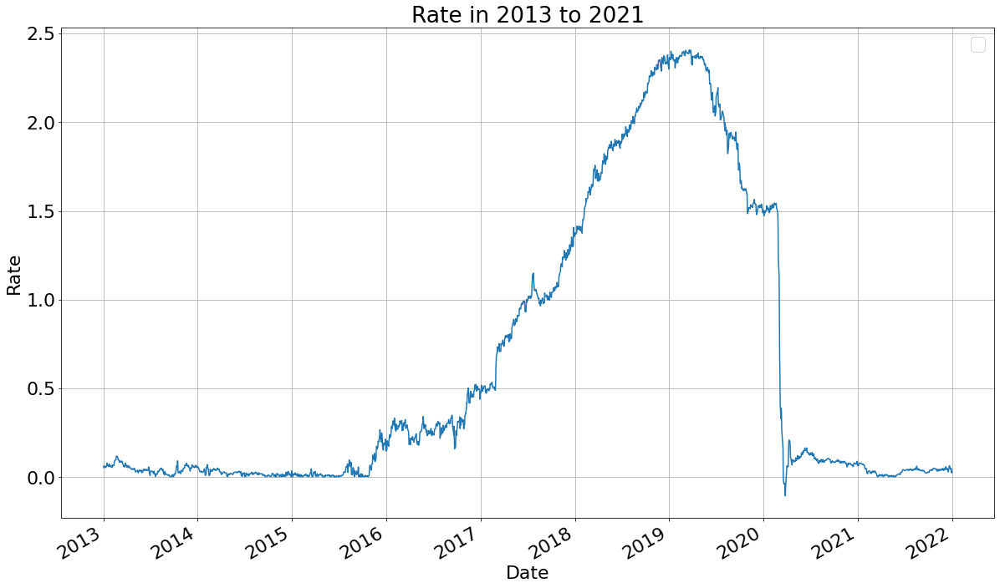

In [17]:
# 13_Week_Treasury_Bill

ax=df.groupby('Date')[['_13_Week_Treasury_Bill_Adj Close']].mean().plot()
plt.grid()
style = dict(size=15, color='gray')

plt.xlabel('Date')
plt.ylabel('Rate')
plt.title('Rate in 2013 to 2021')
plt.savefig('13 Week Treasury Bill in 2013 to 2021', bbox_inches='tight')
plt.show()

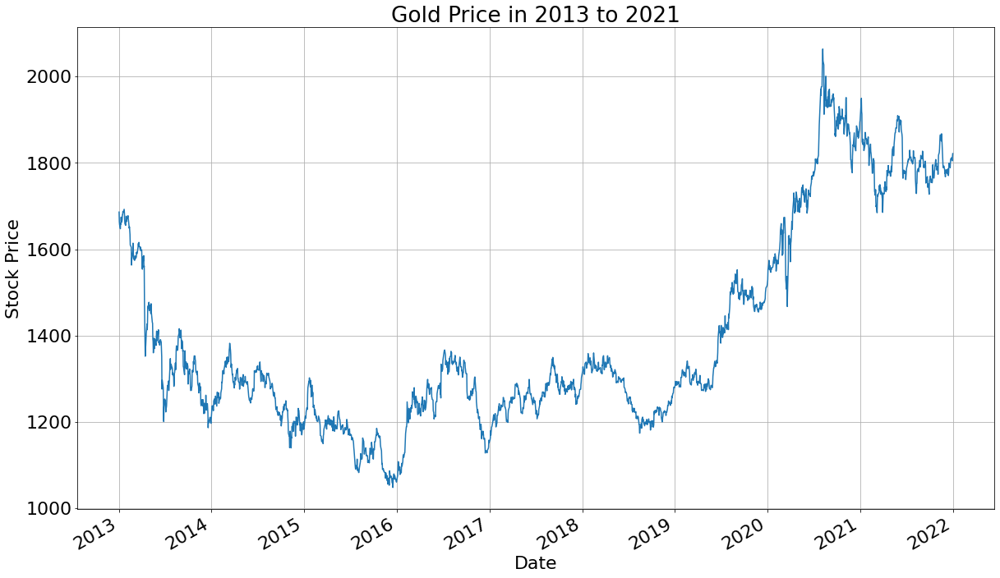

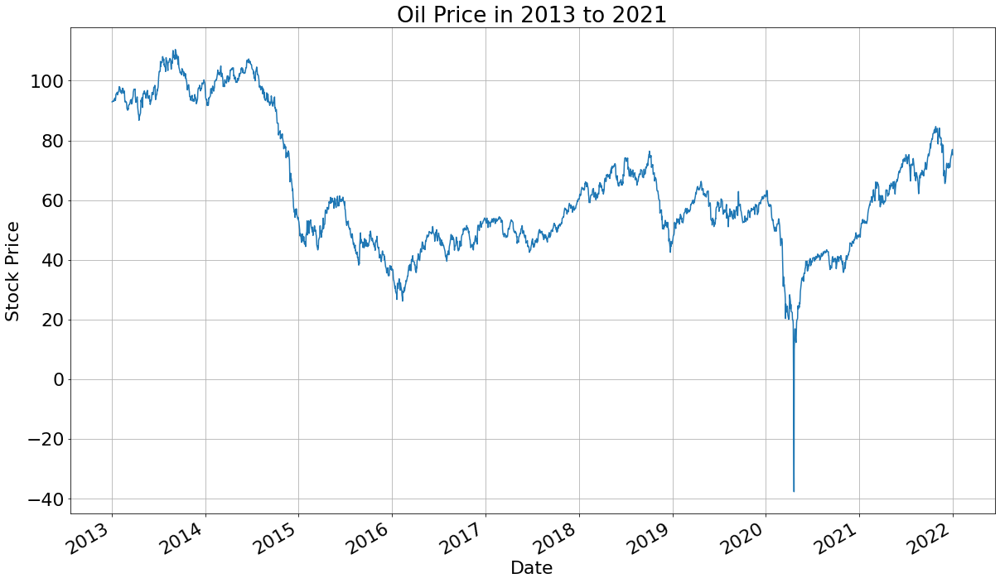

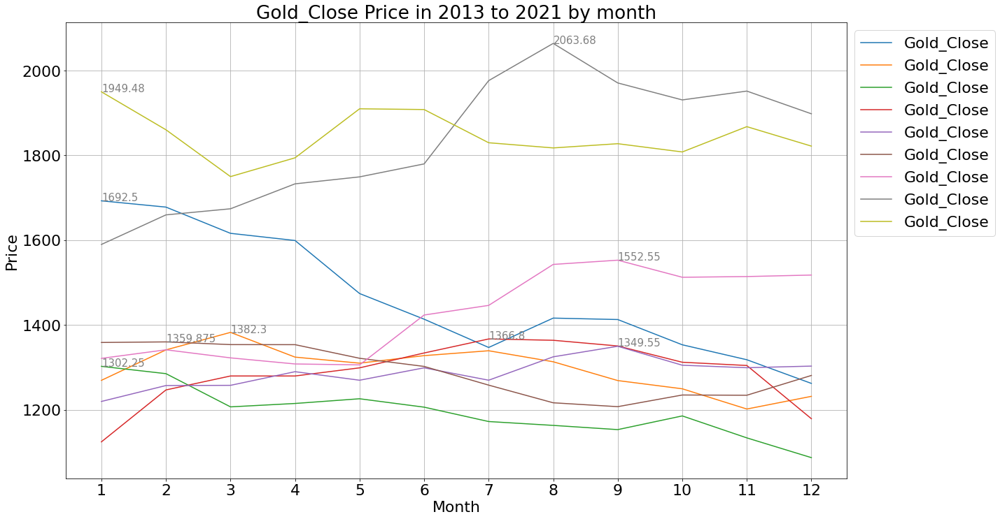

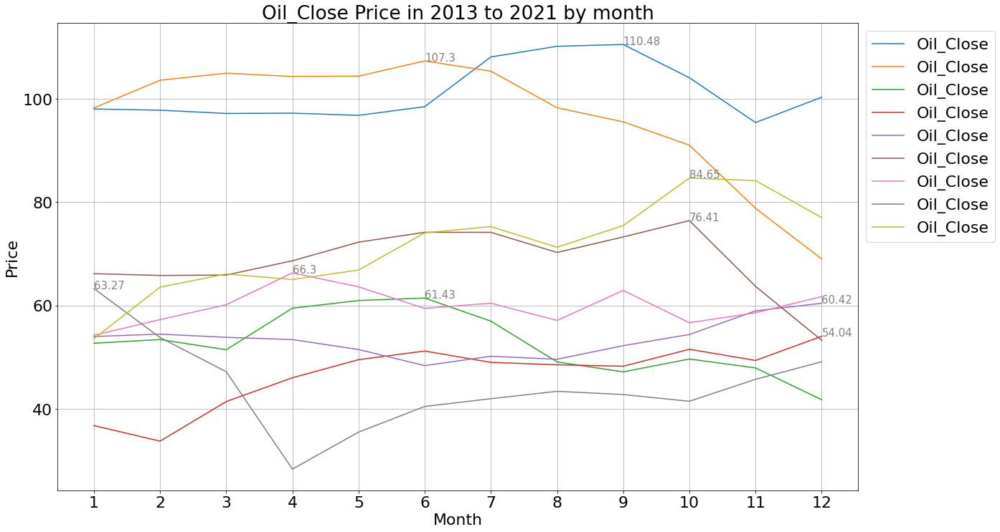

In [18]:
#Gold and Oil


Commodities=['Gold','Oil']
Commodities_adj_list=[i+'_Close' for i in Commodities]

ax=df.groupby('Date')['Gold_Close'].mean().plot()
plt.grid()
style = dict(size=15, color='gray') 

plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.title('Gold Price in 2013 to 2021')
plt.savefig('Gold Price in 2013 to 2021', bbox_inches='tight')
plt.show()

ax=df.groupby('Date')['Oil_Close'].mean().plot()
plt.grid()
style = dict(size=15, color='gray') 

plt.xlabel('Date')
plt.ylabel('Stock Price')
plt.title('Oil Price in 2013 to 2021')
plt.savefig('Oil Price in 2013 to 2021', bbox_inches='tight')
plt.show()


for i in Commodities_adj_list:
    for j in year_an:
        ax=df[df['Year']==j].groupby('Month')[i].max().plot()
        ax.text(df[df['Year']==j].groupby('Month')[i].max().idxmax(), df[df['Year']==j].groupby('Month')[i].max().max(), df[df['Year']==j].groupby('Month')[i].max().max(), **style)

    plt.legend(bbox_to_anchor=(1, 1))
    plt.grid()
    plt.xticks(df.Month.unique())
    plt.xlabel('Month')
    plt.ylabel('Price')
    plt.title('{} Price in 2013 to 2021 by month'.format(i))
    plt.savefig('{} Price in 2013 to 2021 by month'.format(i), bbox_inches='tight')
    plt.show()




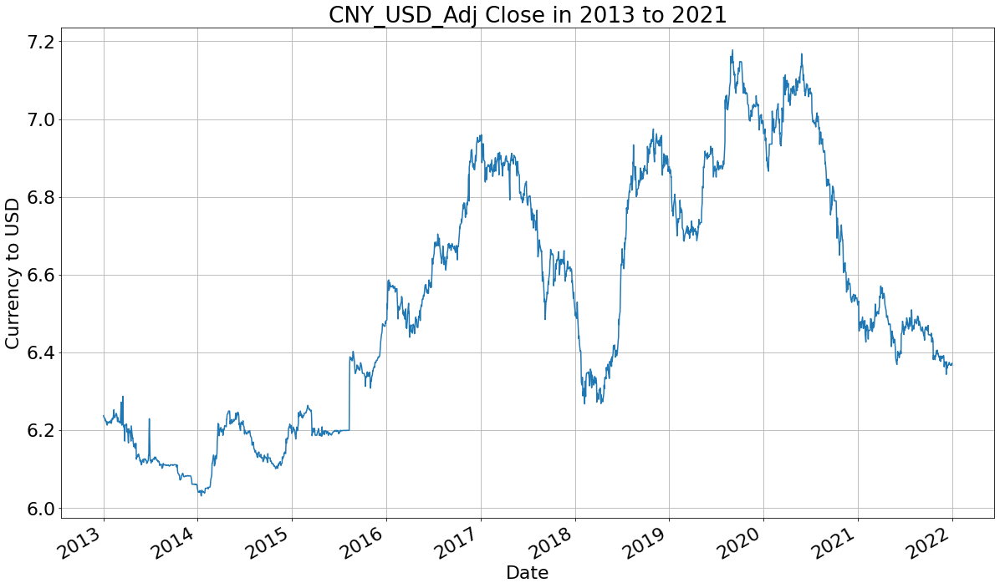

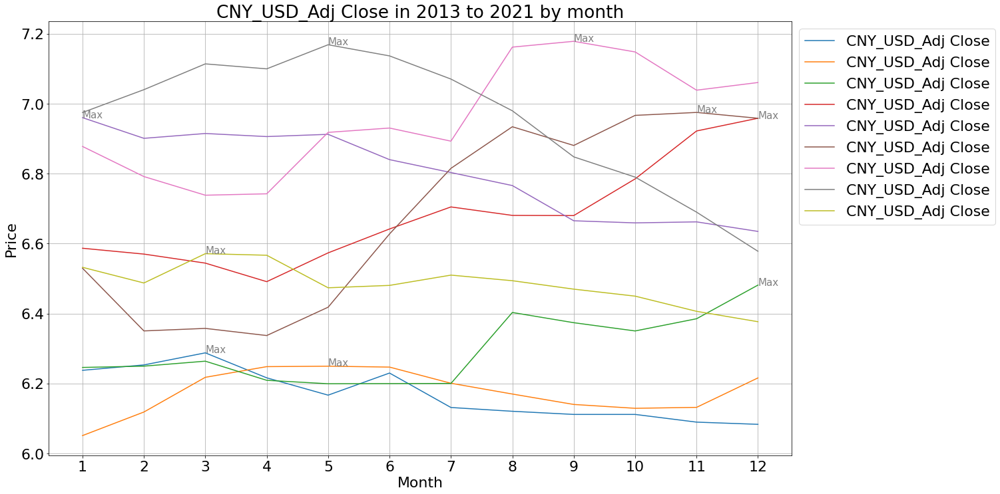

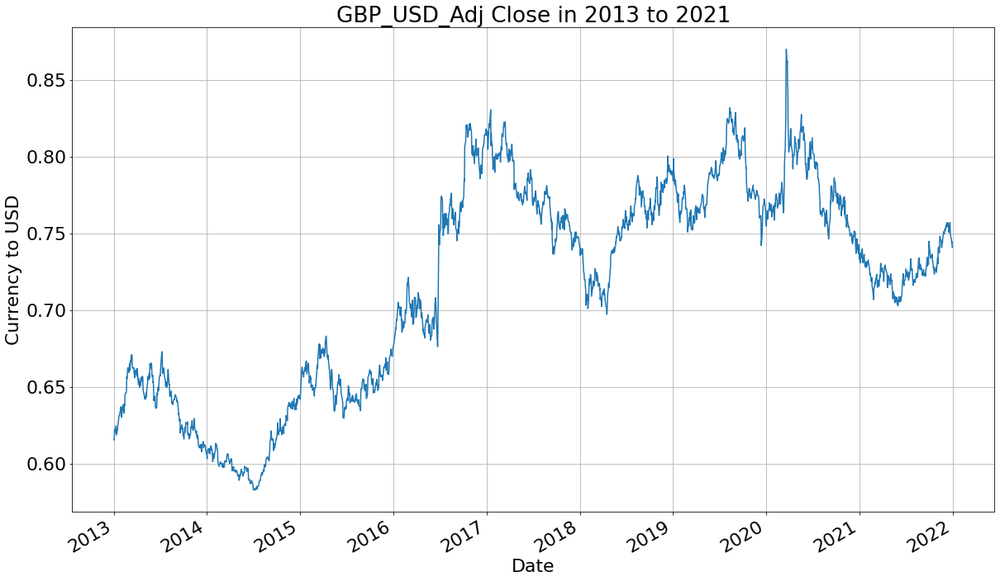

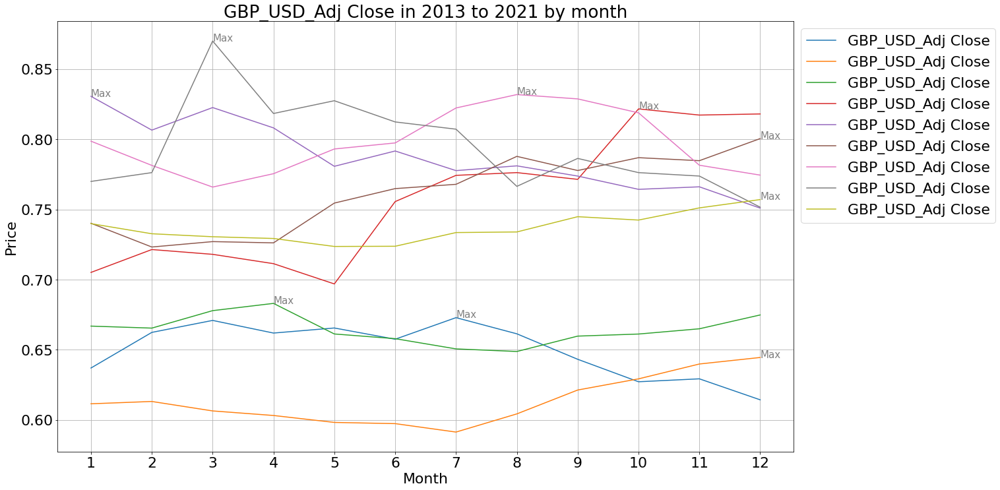

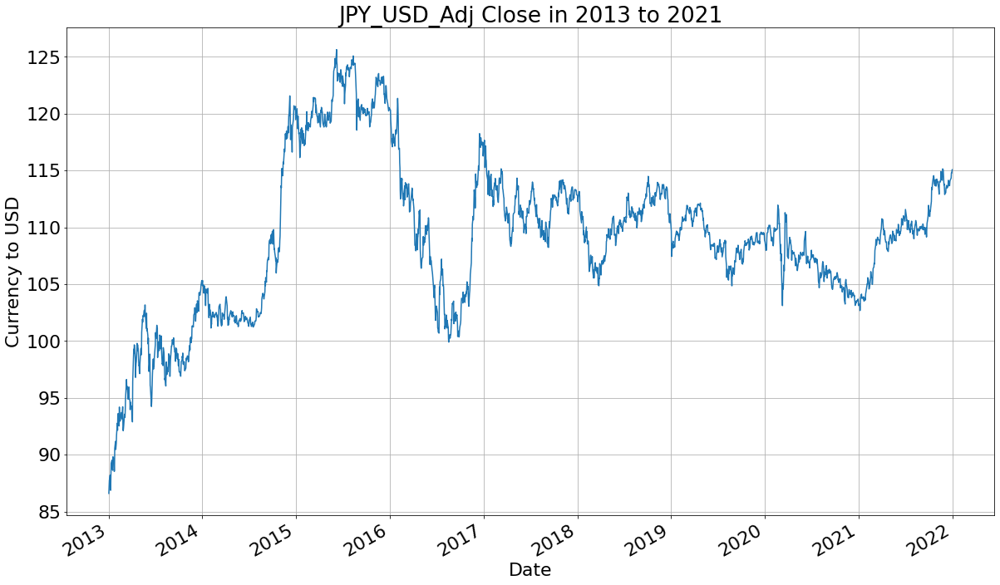

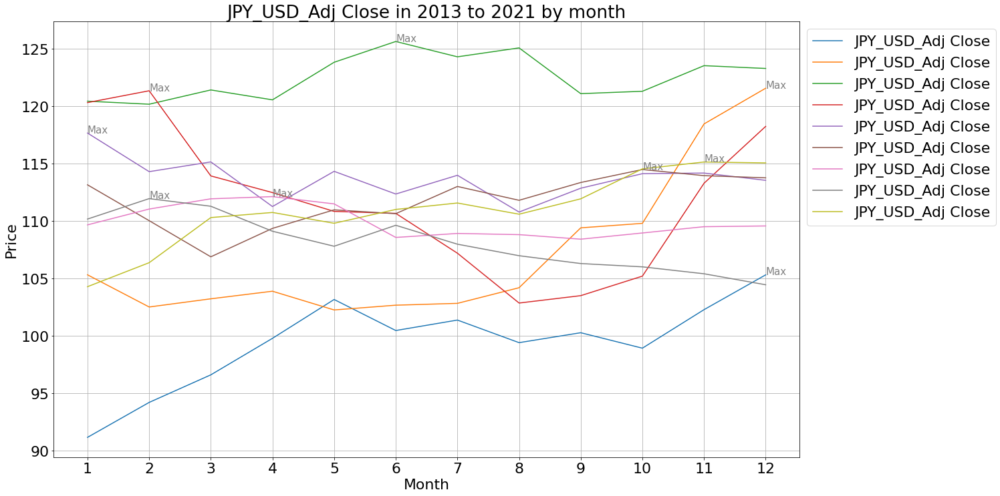

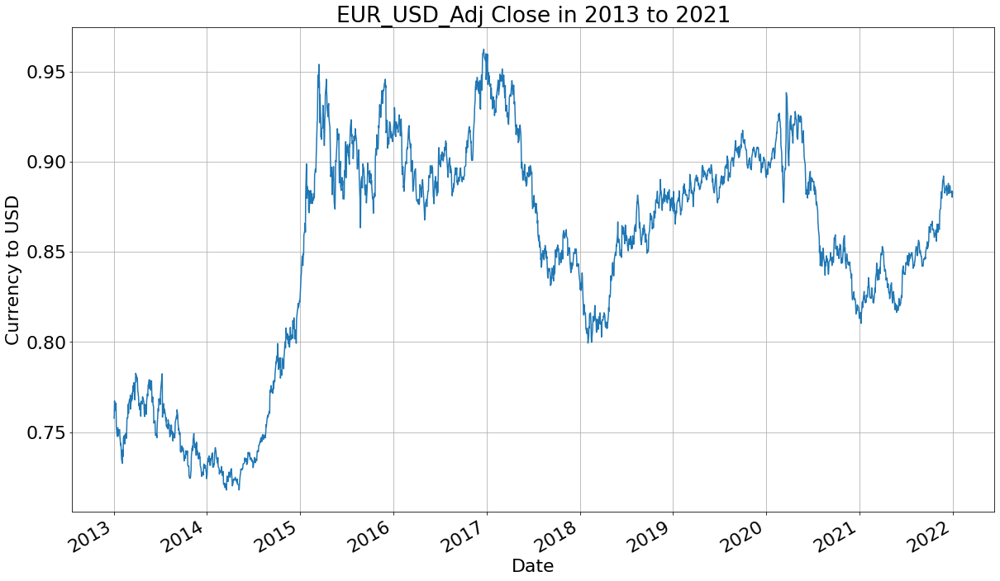

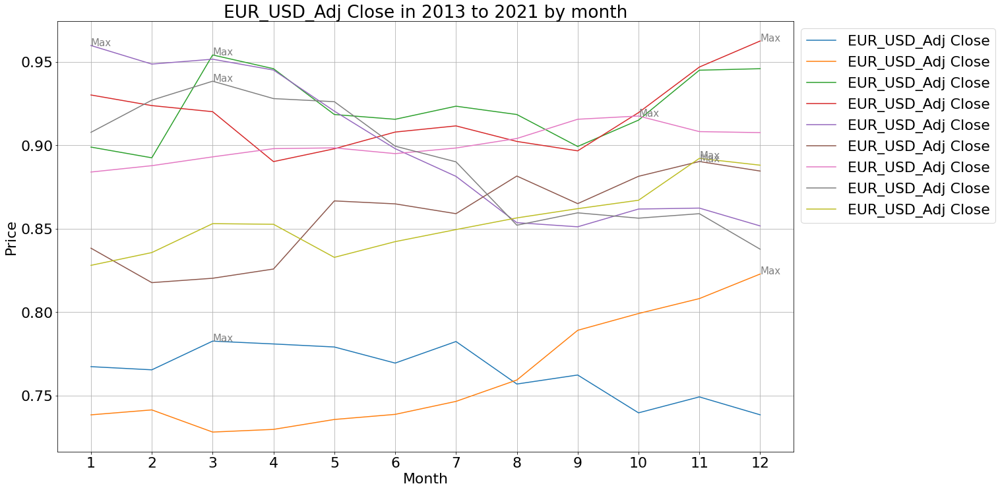

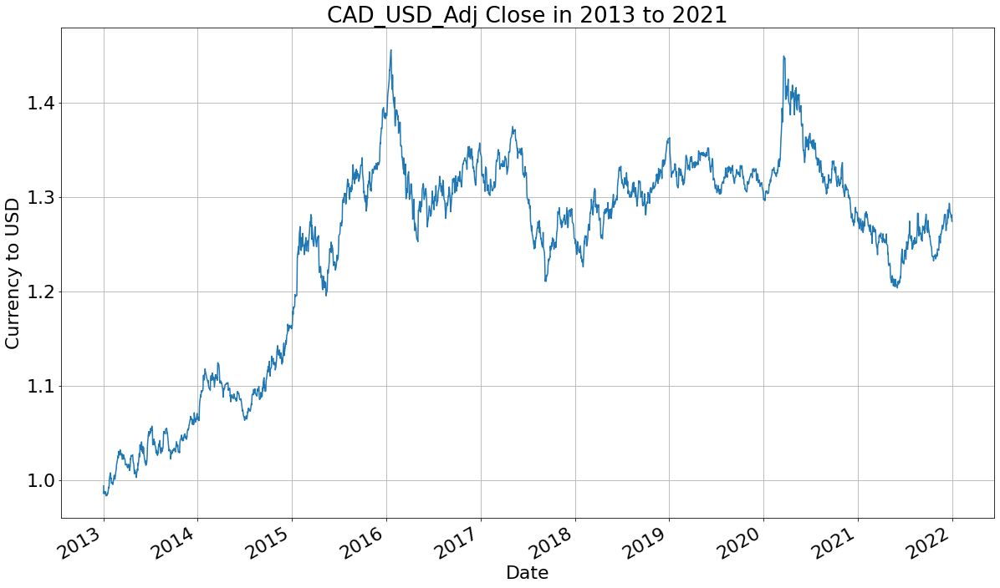

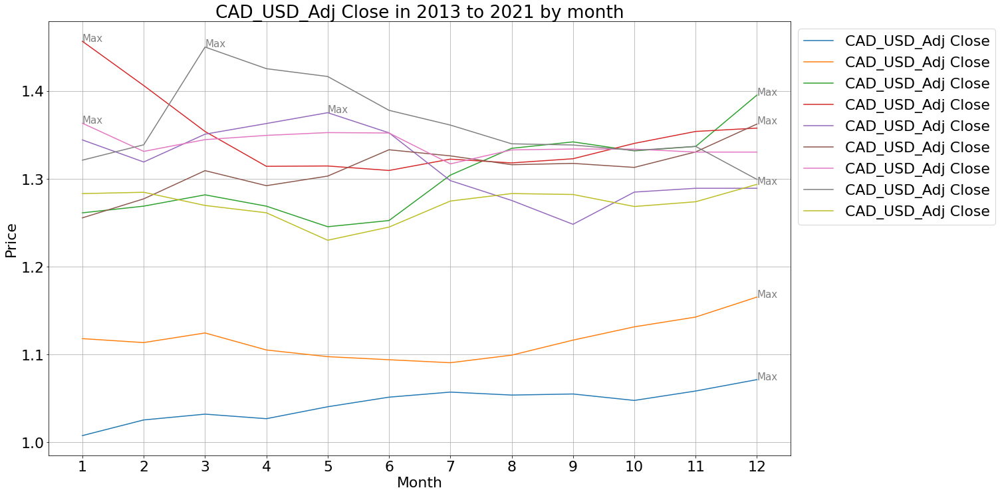

In [19]:
# Currency

#Gold and Oil


Currency=['CNY_USD','GBP_USD','JPY_USD','EUR_USD','CAD_USD']
Currency_adj_list=[i+'_Adj Close' for i in Currency]

for i in Currency_adj_list:
    ax=df.groupby('Date')[i].mean().plot()
    plt.grid()
    style = dict(size=15, color='gray') 
    plt.xlabel('Date')
    plt.ylabel('Currency to USD')
    plt.title('{} in 2013 to 2021'.format(i))
    plt.savefig('{} in 2013 to 2021'.format(i), bbox_inches='tight')
    plt.show()

    for j in year_an:
        ax=df[df['Year']==j].groupby('Month')[i].max().plot()
        ax.text(df[df['Year']==j].groupby('Month')[i].max().idxmax(), df[df['Year']==j].groupby('Month')[i].max().max(), 'Max', **style)

    plt.legend(bbox_to_anchor=(1, 1))
    plt.grid()
    plt.xticks(df.Month.unique())
    plt.xlabel('Month')
    plt.ylabel('Price')
    plt.title('{} in 2013 to 2021 by month'.format(i))
    plt.savefig('{} in 2013 to 2021 by month'.format(i), bbox_inches='tight')
    plt.show()




In [20]:
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2251 entries, 0 to 2250
Data columns (total 348 columns):
 #    Column                                          Dtype         
---   ------                                          -----         
 0    Date                                            datetime64[ns]
 1    NASDAQ_Comp_Open                                float64       
 2    NASDAQ_Comp_High                                float64       
 3    NASDAQ_Comp_Low                                 float64       
 4    NASDAQ_Comp_Close                               float64       
 5    NASDAQ_Comp_Adj Close                           float64       
 6    NASDAQ_Comp_Volume                              float64       
 7    NASDAQ_Comp_%_Daily_Return                      float64       
 8    NASDAQ_Comp_Yesterday_Price_Change              float64       
 9    NASDAQ_Comp_%_Daily_Change                      float64       
 10   NASDAQ_Comp_Daily_Change                        float64   

# Stock price return calculation on 2021-12-31


In [21]:

# 1,3,6 month
#1,3,5,9 years


Stock=['AAPL','MSFT','AMZN','FB','GOOG','GOOGL','TSLA','NVDA','ASML','INTC','CMCSA','NFLX','ADBE','CSCO','PEP','AVGO','TXN','TMUS']
Currency=['CNY_USD','GBP_USD','JPY_USD','EUR_USD','CAD_USD']
Index=['NASDAQ_Comp','Dow_Jones','S_P_500']
Commodities=['Gold','Oil']
col_list1=Index+Commodities
col_list=Stock+Currency

AAPL = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^AAPL', axis=1)], axis=1)
MSFT = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^MSFT', axis=1)], axis=1)
AMZN = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^AMZN', axis=1)], axis=1)
FB = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^FB', axis=1)], axis=1)
GOOG = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^GOOG', axis=1)], axis=1)
GOOGL = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^GOOGL', axis=1)], axis=1)
TSLA = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^TSLA', axis=1)], axis=1)
NVDA = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^NVDA', axis=1)], axis=1)
ASML = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^ASML', axis=1)], axis=1)
INTC = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^INTC', axis=1)], axis=1)
CMCSA = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^CMCSA', axis=1)], axis=1)
NFLX = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^NFLX', axis=1)], axis=1)
ADBE = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^ADBE', axis=1)], axis=1)
CSCO = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^CSCO', axis=1)], axis=1)
PEP = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^PEP', axis=1)], axis=1)
AVGO = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^AVGO', axis=1)], axis=1)
TXN = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^TXN', axis=1)], axis=1)
TMUS = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^TMUS', axis=1)], axis=1)
CNY_USD = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^CNY_USD', axis=1)], axis=1)
GBP_USD = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^GBP_USD', axis=1)], axis=1)
JPY_USD = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^JPY_USD', axis=1)], axis=1)
EUR_USD = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^EUR_USD', axis=1)], axis=1)
CAD_USD = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^CAD_USD', axis=1)], axis=1)

NASDAQ_Comp = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^NASDAQ_Comp', axis=1)], axis=1)
Dow_Jones = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^Dow_Jones', axis=1)], axis=1)
S_P_500 = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^S_P_500', axis=1)], axis=1)
Gold = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^Gold', axis=1)], axis=1)
Oil = pd.concat([df.filter(items=['Date']), df.filter(regex=r'^Oil', axis=1)], axis=1)

df_list=[AAPL, MSFT, AMZN, FB, GOOG, GOOGL, TSLA, NVDA, ASML, INTC, CMCSA, NFLX, ADBE, CSCO, PEP,
         AVGO, TXN, TMUS, CNY_USD, GBP_USD, JPY_USD, EUR_USD, CAD_USD]

df_list1=[NASDAQ_Comp,Dow_Jones,S_P_500,Gold,Oil]

In [22]:
idx_date_end=df.Date.idxmax()
idx_date_min=df.Date.idxmin()
i=0
dict_return={'Stock_Currency':[],'1_month_return':[],'3_months_return':[],'6_months_return':[],'1_year_return':[],'3_years_return':[],'5_years_return':[],'9_years_return':[]}
dict_return1={'Index_Commodities':[],'1_month_return':[],'3_months_return':[],'6_months_return':[],'1_year_return':[],'3_years_return':[],'5_years_return':[],'9_years_return':[]}


for a in df_list:
    dict_return['Stock_Currency'].append(col_list[i])
    dict_return['1_month_return'].append((a.loc[idx_date_end]['{}_Adj Close'.format(col_list[i])]-a.loc[idx_date_end-30]['{}_Adj Close'.format(col_list[i])])/a.loc[idx_date_end-30]['{}_Adj Close'.format(col_list[i])]*100)
    dict_return['3_months_return'].append((a.loc[idx_date_end]['{}_Adj Close'.format(col_list[i])]-a.loc[idx_date_end-90]['{}_Adj Close'.format(col_list[i])])/a.loc[idx_date_end-90]['{}_Adj Close'.format(col_list[i])]*100)
    dict_return['6_months_return'].append((a.loc[idx_date_end]['{}_Adj Close'.format(col_list[i])]-a.loc[idx_date_end-180]['{}_Adj Close'.format(col_list[i])])/a.loc[idx_date_end-180]['{}_Adj Close'.format(col_list[i])]*100)
    dict_return['1_year_return'].append((a.loc[idx_date_end]['{}_Adj Close'.format(col_list[i])]-a.loc[idx_date_end-365]['{}_Adj Close'.format(col_list[i])])/a.loc[idx_date_end-365]['{}_Adj Close'.format(col_list[i])]*100)
    dict_return['3_years_return'].append((a.loc[idx_date_end]['{}_Adj Close'.format(col_list[i])]-a.loc[idx_date_end-365*3]['{}_Adj Close'.format(col_list[i])])/a.loc[idx_date_end-365*3]['{}_Adj Close'.format(col_list[i])]*100)
    dict_return['5_years_return'].append((a.loc[idx_date_end]['{}_Adj Close'.format(col_list[i])]-a.loc[idx_date_end-365*5-1]['{}_Adj Close'.format(col_list[i])])/a.loc[idx_date_end-365*5-1]['{}_Adj Close'.format(col_list[i])]*100)
    dict_return['9_years_return'].append((a.loc[idx_date_end]['{}_Adj Close'.format(col_list[i])]-a.loc[idx_date_min]['{}_Adj Close'.format(col_list[i])])/a.loc[idx_date_min]['{}_Adj Close'.format(col_list[i])]*100)
    i+=1

i=0

for a in df_list1:
    idx_date_end=a.Date.idxmax()
    idx_date_min=a.Date.idxmin()
    dict_return1['Index_Commodities'].append(col_list1[i])
    dict_return1['1_month_return'].append((a.loc[idx_date_end]['{}_Close'.format(col_list1[i])]-a.loc[idx_date_end-30]['{}_Close'.format(col_list1[i])])/a.loc[idx_date_end-30]['{}_Close'.format(col_list1[i])])
    dict_return1['3_months_return'].append((a.loc[idx_date_end]['{}_Close'.format(col_list1[i])]-a.loc[idx_date_end-90]['{}_Close'.format(col_list1[i])])/a.loc[idx_date_end-90]['{}_Close'.format(col_list1[i])])
    dict_return1['6_months_return'].append((a.loc[idx_date_end]['{}_Close'.format(col_list1[i])]-a.loc[idx_date_end-180]['{}_Close'.format(col_list1[i])])/a.loc[idx_date_end-180]['{}_Close'.format(col_list1[i])])
    dict_return1['1_year_return'].append((a.loc[idx_date_end]['{}_Close'.format(col_list1[i])]-a.loc[idx_date_end-365]['{}_Close'.format(col_list1[i])])/a.loc[idx_date_end-365]['{}_Close'.format(col_list1[i])])
    dict_return1['3_years_return'].append((a.loc[idx_date_end]['{}_Close'.format(col_list1[i])]-a.loc[idx_date_end-365*3]['{}_Close'.format(col_list1[i])])/a.loc[idx_date_end-365*3]['{}_Close'.format(col_list1[i])])
    dict_return1['5_years_return'].append((a.loc[idx_date_end]['{}_Close'.format(col_list1[i])]-a.loc[idx_date_end-365*5-1]['{}_Close'.format(col_list1[i])])/a.loc[idx_date_end-365*5-1]['{}_Close'.format(col_list1[i])])
    dict_return1['9_years_return'].append((a.loc[idx_date_end]['{}_Close'.format(col_list1[i])]-a.loc[idx_date_min]['{}_Close'.format(col_list1[i])])/a.loc[idx_date_min]['{}_Close'.format(col_list1[i])])
    i+=1

    
df_return=pd.DataFrame(dict_return)
df_return1=pd.DataFrame(dict_return1)

In [23]:
NASDAQ_Comp.loc[idx_date_end-30]['NASDAQ_Comp_Close']

15973.86035

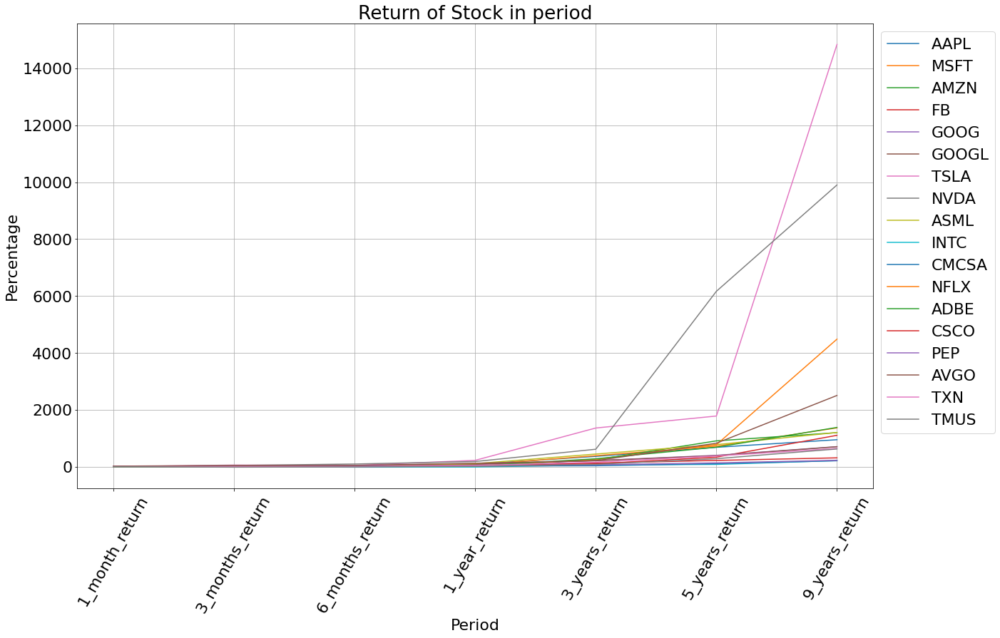

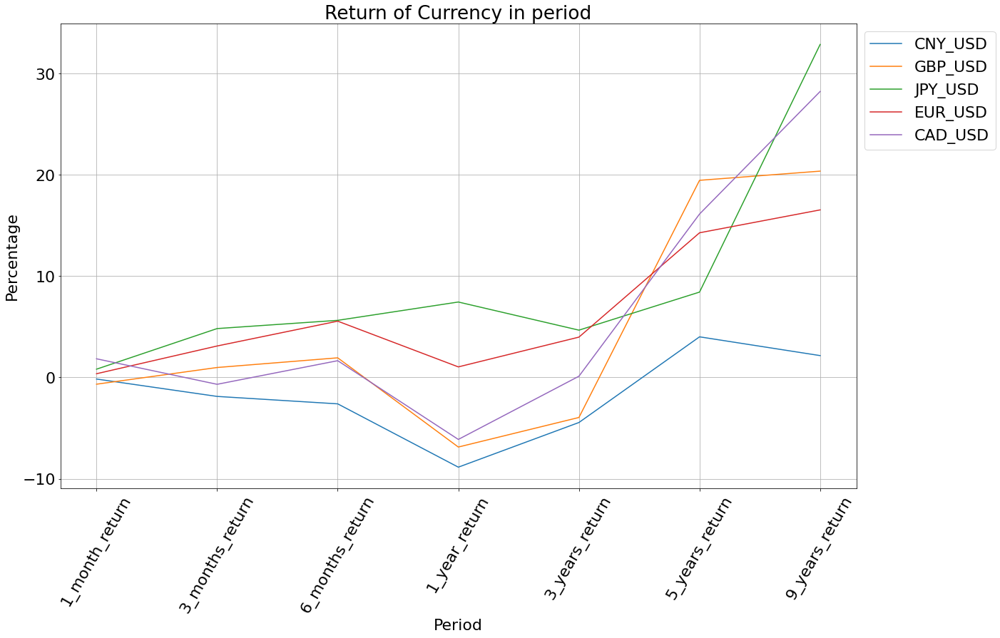

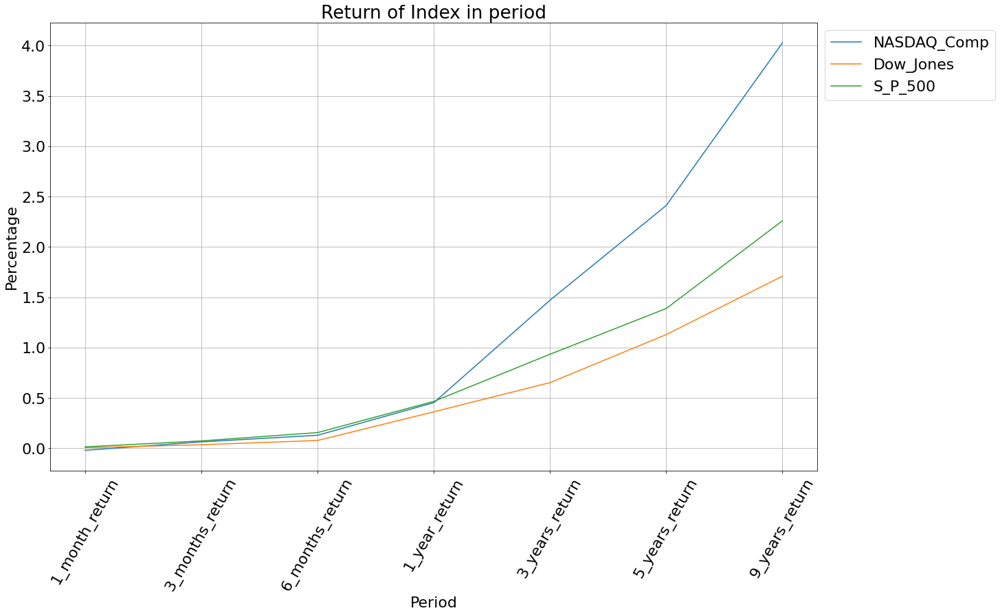

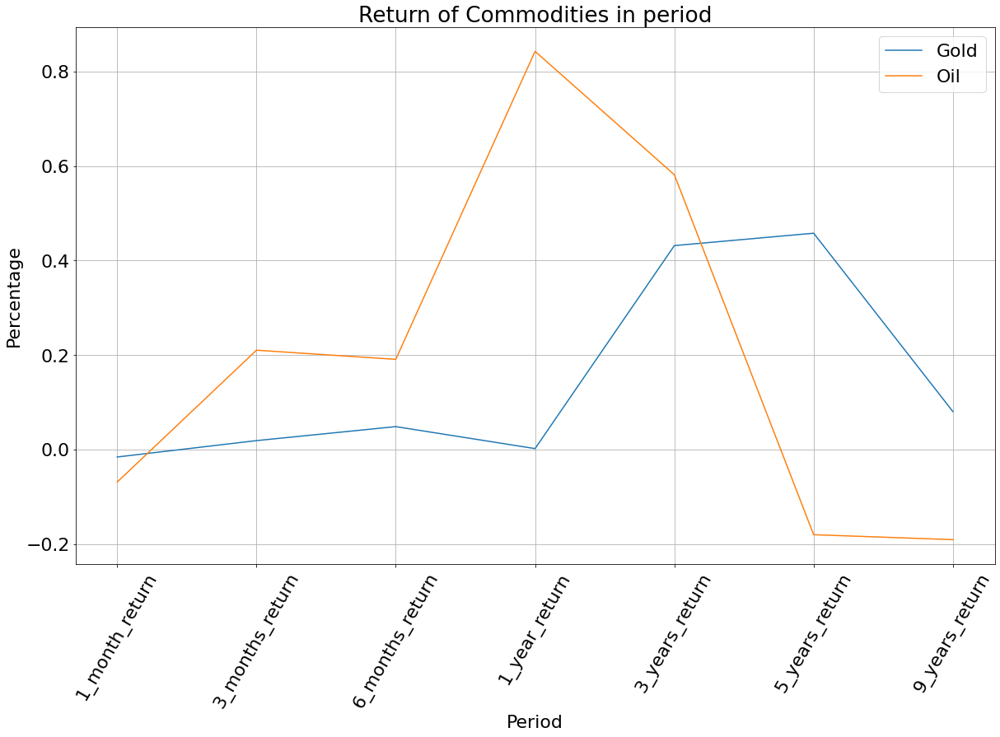

In [24]:
df_return.set_index('Stock_Currency').transpose()[Stock].plot()
plt.legend(bbox_to_anchor=(1, 1))
plt.grid()
plt.xticks(rotation=60)
plt.xlabel('Period')
plt.ylabel('Percentage')
plt.title('Return of Stock in period')
plt.savefig('Return of Stock in period', bbox_inches='tight')
plt.show()

df_return.set_index('Stock_Currency').transpose()[Currency].plot()
plt.legend(bbox_to_anchor=(1, 1))
plt.grid()
plt.xticks(rotation=60)
plt.xlabel('Period')
plt.ylabel('Percentage')
plt.title('Return of Currency in period')
plt.savefig('Return of Currency in period', bbox_inches='tight')
plt.show()

df_return1.set_index('Index_Commodities').transpose()[Index].plot()
plt.legend(bbox_to_anchor=(1, 1))
plt.grid()
plt.xticks(rotation=60)
plt.xlabel('Period')
plt.ylabel('Percentage')
plt.title('Return of Index in period')
plt.savefig('Return of Index in period', bbox_inches='tight')
plt.show()

df_return1.set_index('Index_Commodities').transpose()[Commodities].plot()
plt.legend(bbox_to_anchor=(1, 1))
plt.grid()
plt.xticks(rotation=60)
plt.xlabel('Period')
plt.ylabel('Percentage')
plt.title('Return of Commodities in period')
plt.savefig('Return of Commodities in period', bbox_inches='tight')
plt.show()

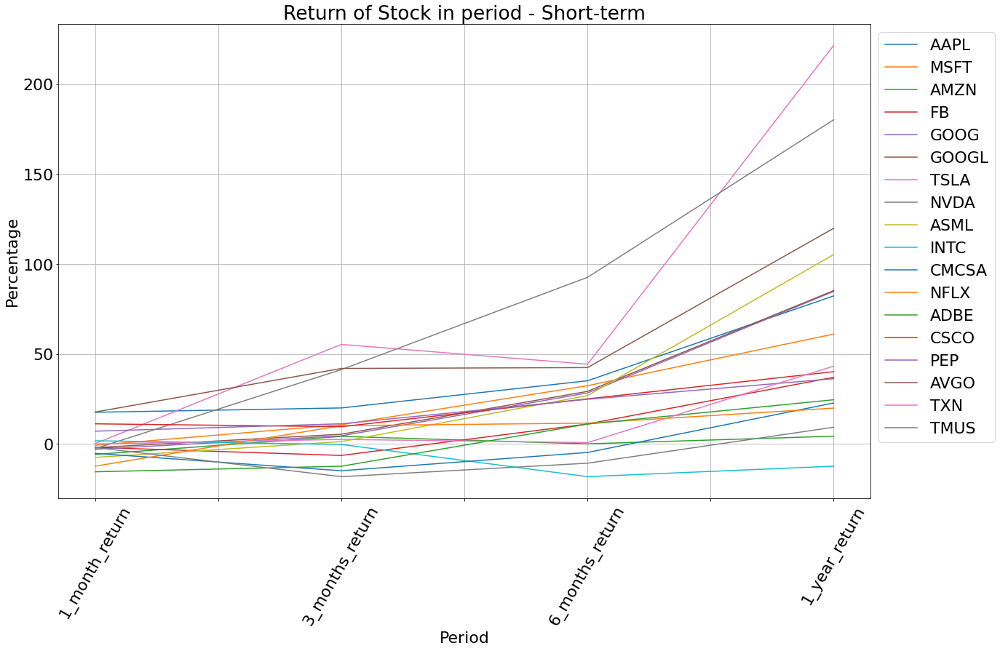

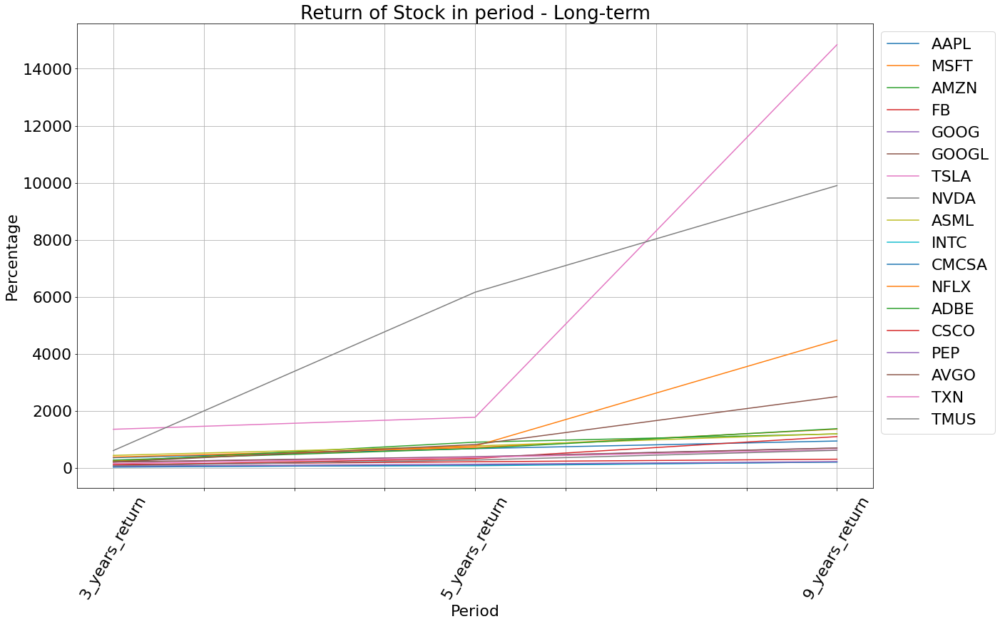

In [25]:
df_return[['Stock_Currency','1_month_return','3_months_return','6_months_return','1_year_return']].set_index('Stock_Currency').transpose()[Stock].plot()
plt.legend(bbox_to_anchor=(1, 1))
plt.grid()
plt.xticks(rotation=60)
plt.xlabel('Period')
plt.ylabel('Percentage')
plt.title('Return of Stock in period - Short-term')
plt.savefig('Return of Stock in period - Short-term', bbox_inches='tight')
plt.show()


df_return[['Stock_Currency','3_years_return','5_years_return','9_years_return']].set_index('Stock_Currency').transpose()[Stock].plot()
plt.legend(bbox_to_anchor=(1, 1))
plt.grid()
plt.xticks(rotation=60)
plt.xlabel('Period')
plt.ylabel('Percentage')
plt.title('Return of Stock in period - Long-term')
plt.savefig('Return of Stock in period - Long-term', bbox_inches='tight')
plt.show()


# Correlation

(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5, 12.5, 13.5, 14.5, 15.5, 16.5, 17.5, 18.5, 19.5, 20.5, 21.5,
        22.5, 23.5, 24.5, 25.5, 26.5, 27.5, 28.5, 29.5, 30.5, 31.5]),
 [Text(0.5, 0, 'NASDAQ_Comp'),
  Text(1.5, 0, 'Dow_Jones'),
  Text(2.5, 0, 'S_P_500'),
  Text(3.5, 0, 'AAPL'),
  Text(4.5, 0, 'MSFT'),
  Text(5.5, 0, 'AMZN'),
  Text(6.5, 0, 'FB'),
  Text(7.5, 0, 'GOOG'),
  Text(8.5, 0, 'GOOGL'),
  Text(9.5, 0, 'TSLA'),
  Text(10.5, 0, 'NVDA'),
  Text(11.5, 0, 'ASML'),
  Text(12.5, 0, 'INTC'),
  Text(13.5, 0, 'CMCSA'),
  Text(14.5, 0, 'NFLX'),
  Text(15.5, 0, 'ADBE'),
  Text(16.5, 0, 'CSCO'),
  Text(17.5, 0, 'PEP'),
  Text(18.5, 0, 'AVGO'),
  Text(19.5, 0, 'TXN'),
  Text(20.5, 0, 'TMUS'),
  Text(21.5, 0, '_13_Week_Treasury_Bill'),
  Text(22.5, 0, 'Treasury_Yield_5_Years'),
  Text(23.5, 0, 'Treasury_Yield_10_Years'),
  Text(24.5, 0, 'Treasury_Yield_30_Years'),
  Text(25.5, 0, 'Gold'),
  Text(26.5, 0, 'Oil'),
  Text(27.5, 0, 'CNY_USD'),
  T

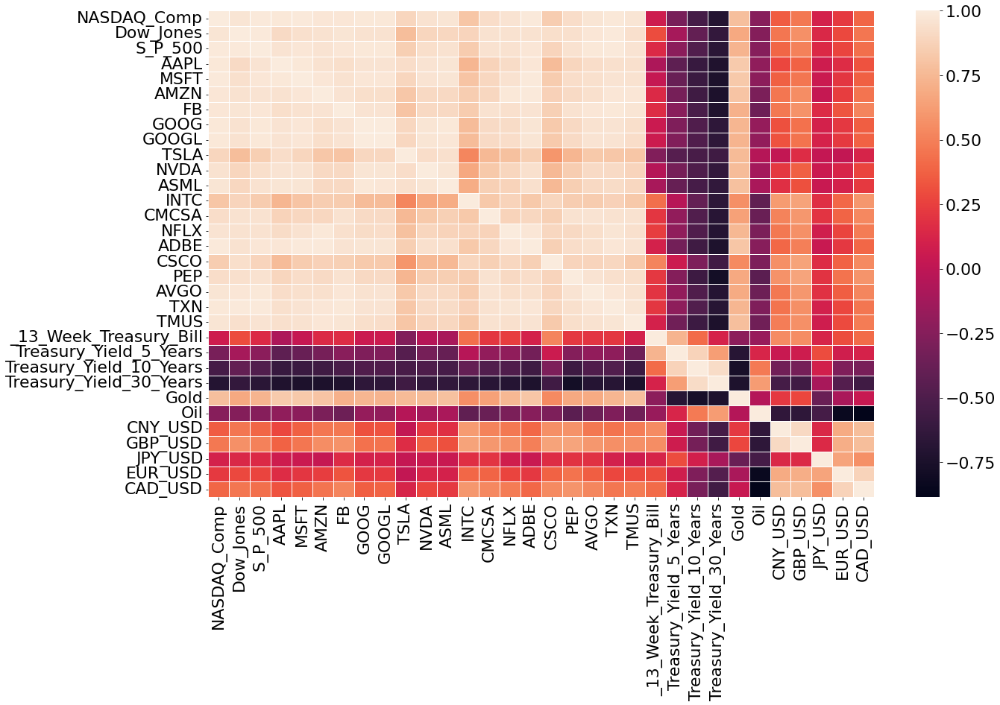

In [27]:
cor_df_AdjClose = pd.concat([df.filter(regex=r'_Close', axis=1)], axis=1)
cor_df_AdjClose.columns=['NASDAQ_Comp', 'Dow_Jones', 'S_P_500', 'AAPL',
       'MSFT', 'AMZN', 'FB', 'GOOG', 'GOOGL',
       'TSLA', 'NVDA', 'ASML', 'INTC', 'CMCSA',
       'NFLX', 'ADBE', 'CSCO', 'PEP', 'AVGO',
       'TXN', 'TMUS', '_13_Week_Treasury_Bill',
       'Treasury_Yield_5_Years', 'Treasury_Yield_10_Years',
       'Treasury_Yield_30_Years', 'Gold', 'Oil',
       'CNY_USD', 'GBP_USD', 'JPY_USD', 'EUR_USD',
       'CAD_USD']
sns.heatmap(cor_df_AdjClose.corr(),linewidths=.5,xticklabels=True, yticklabels=True)
plt.xticks(rotation=90)

# DayOfWeek Test

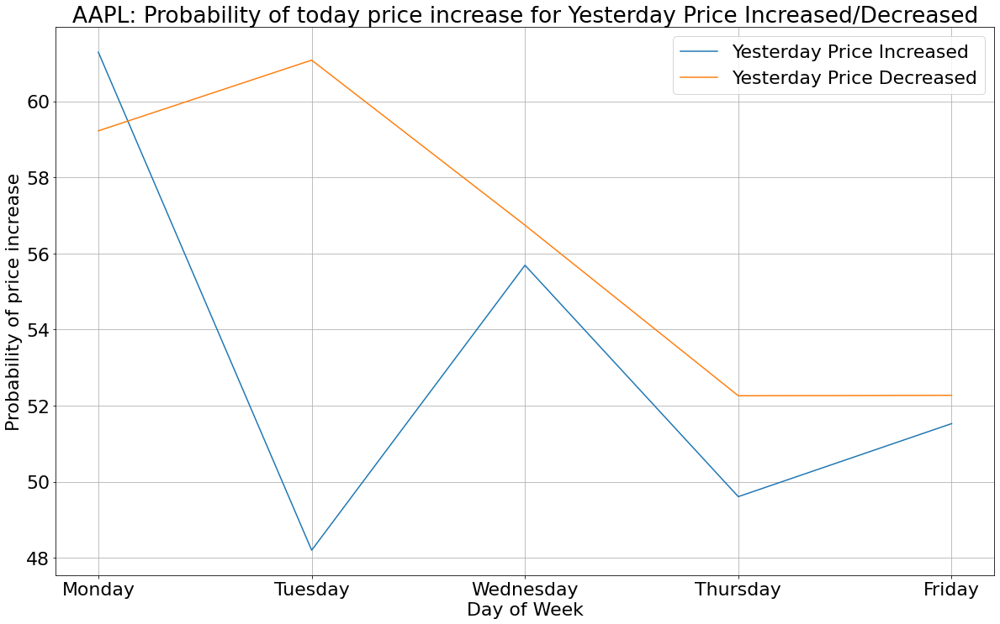

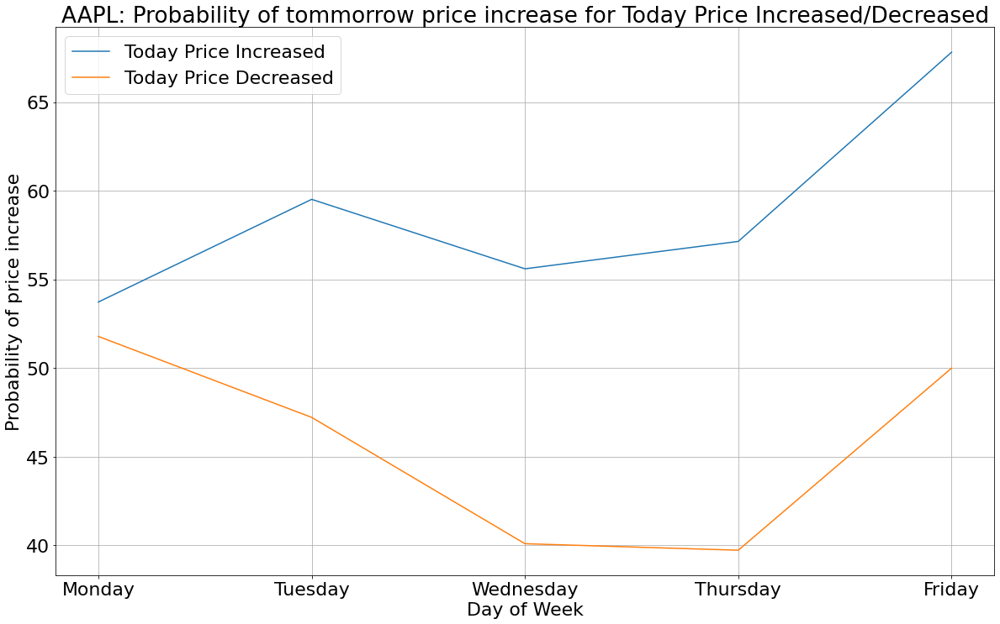

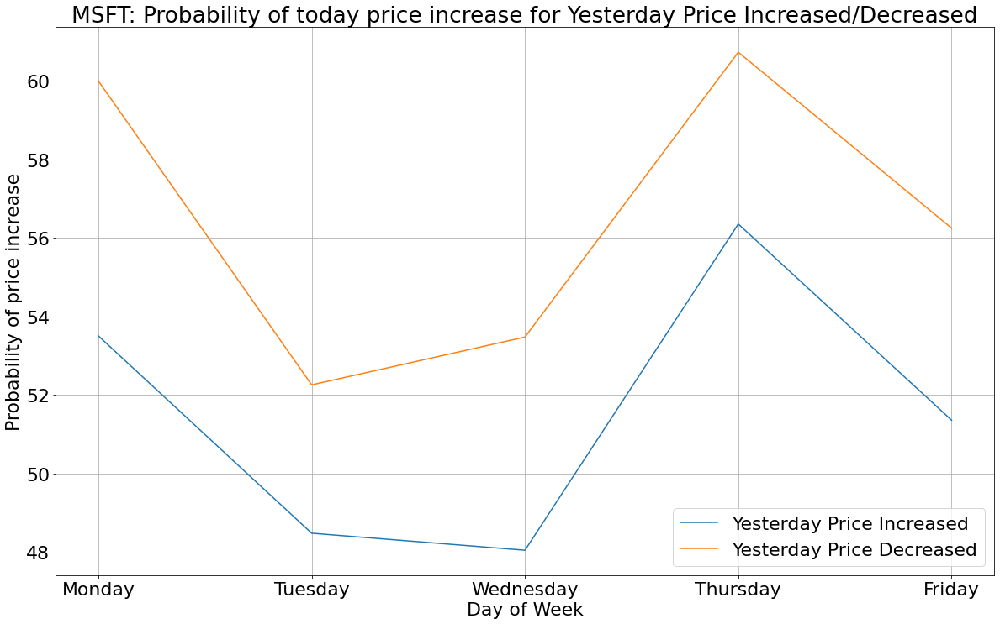

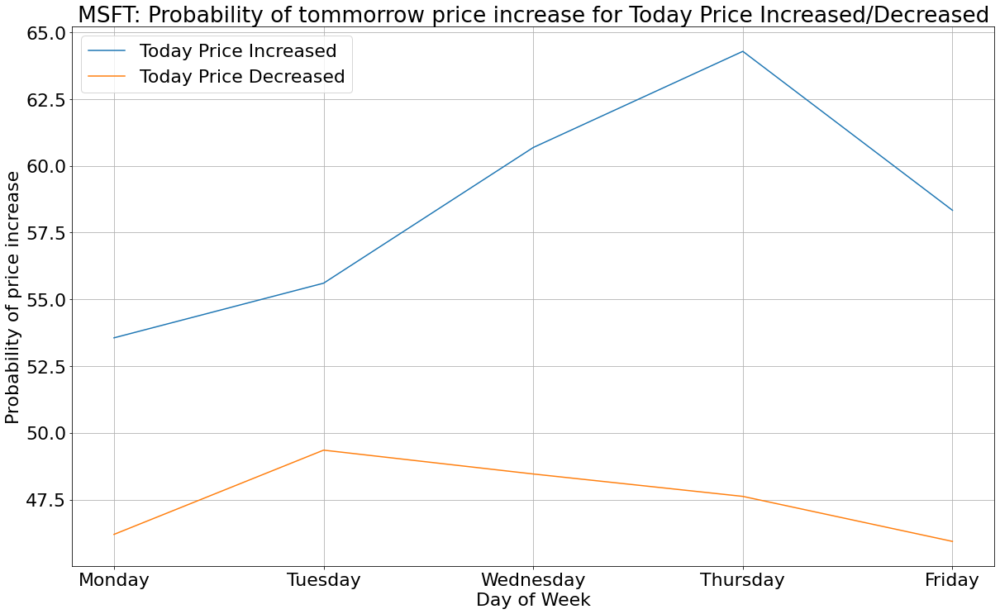

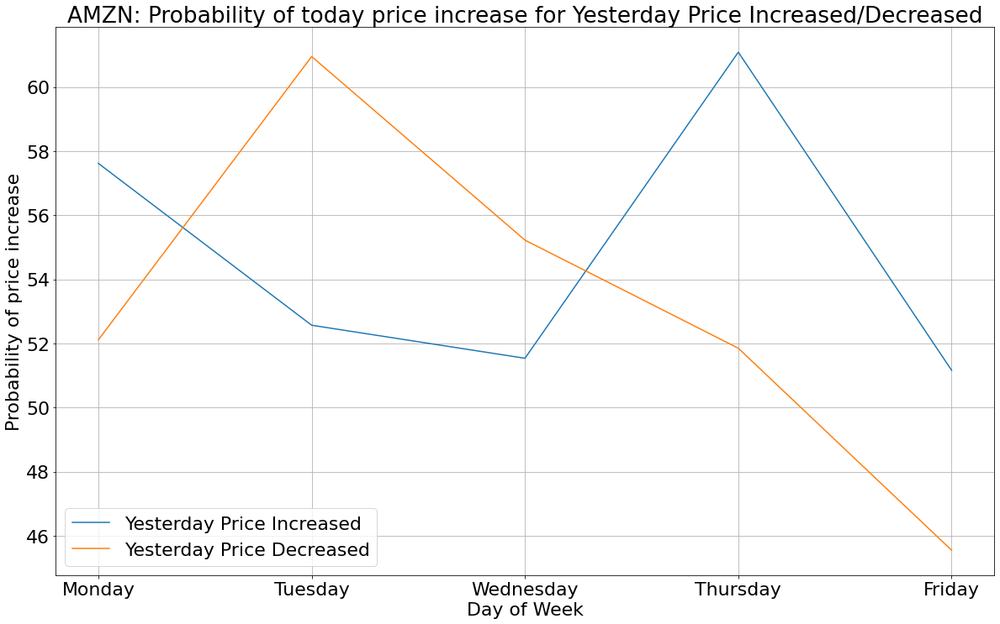

...

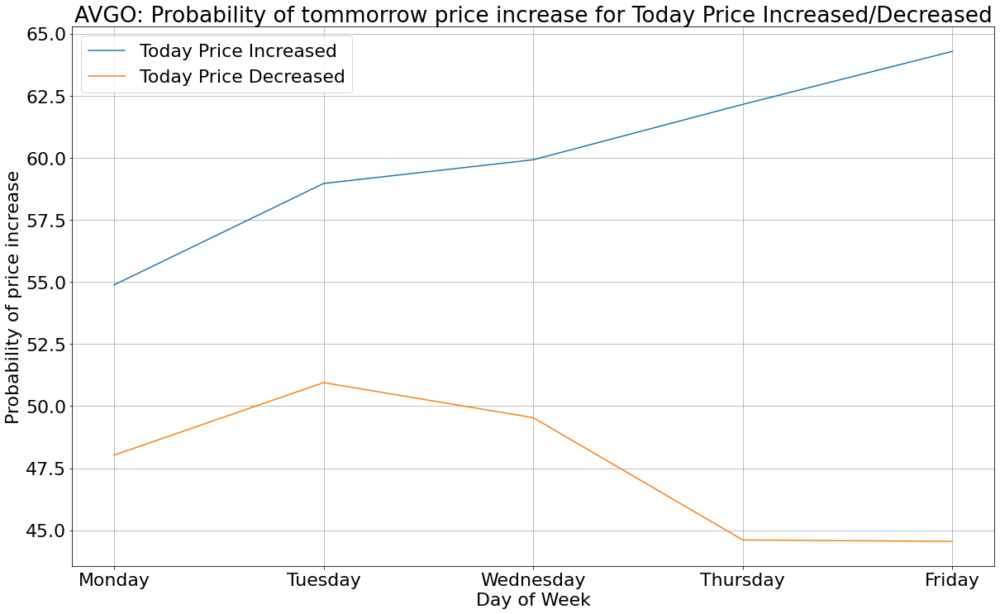

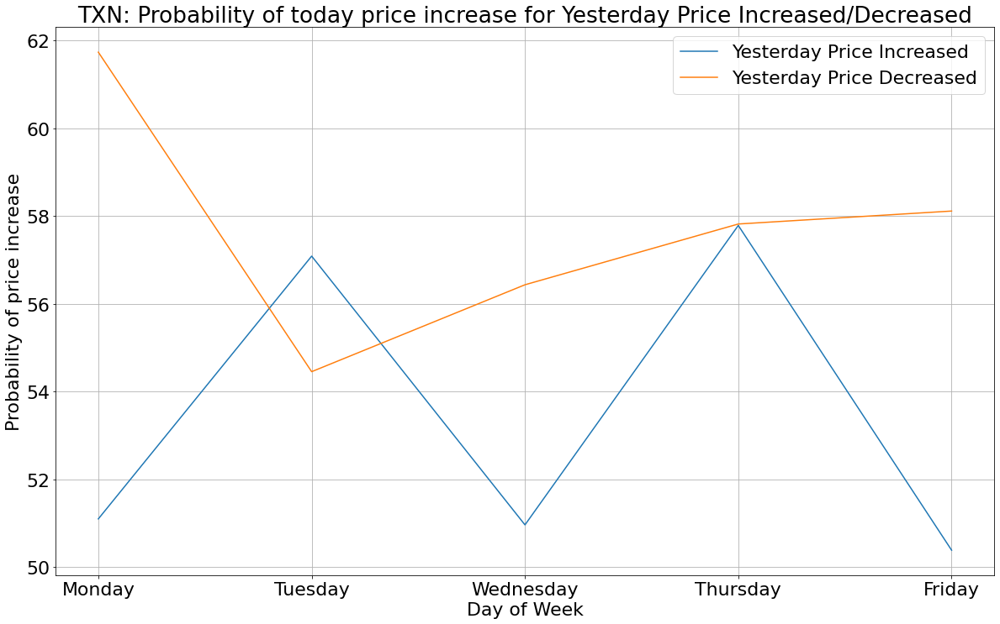

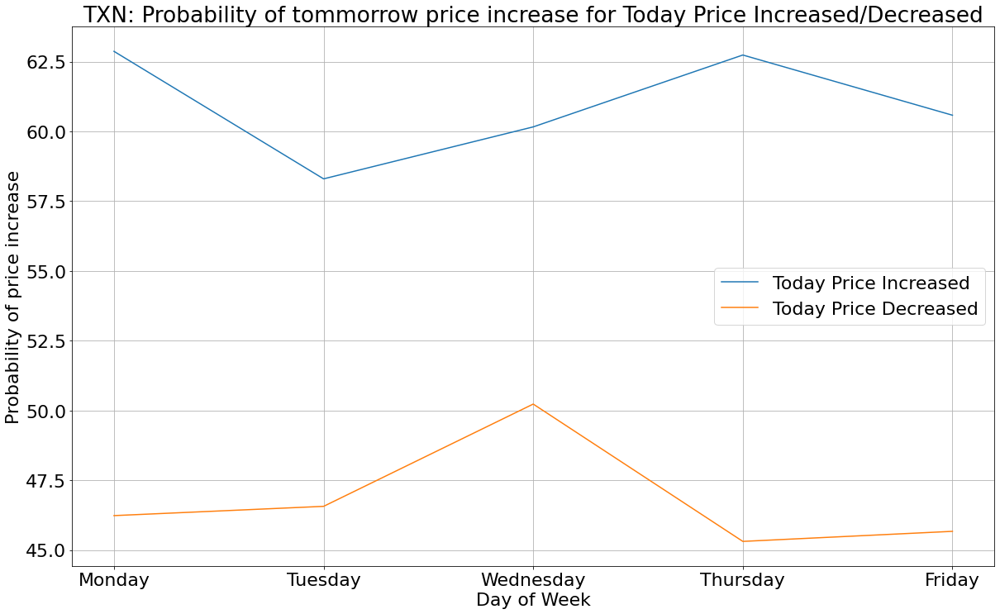

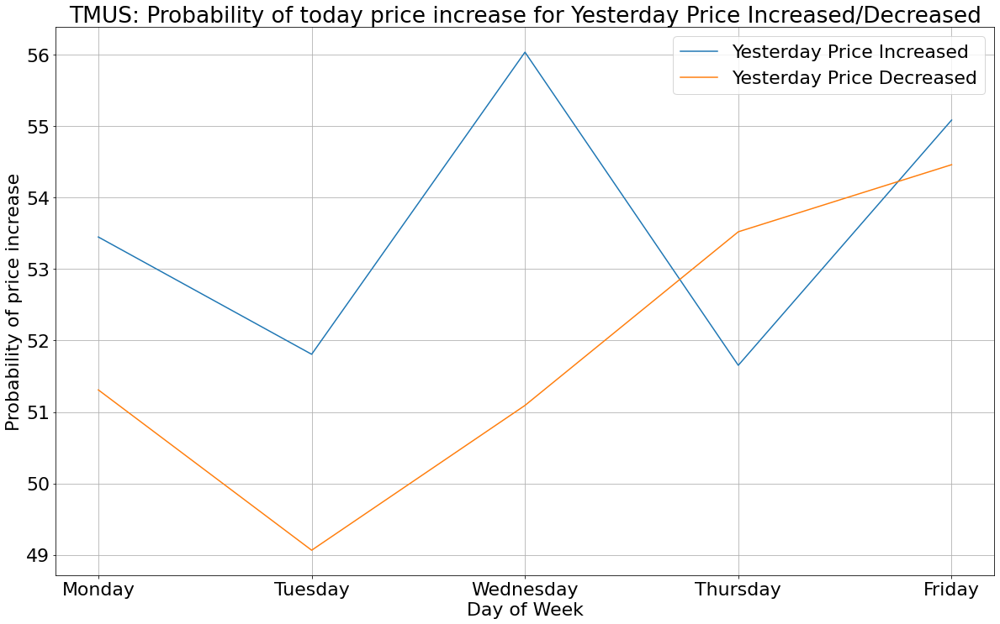

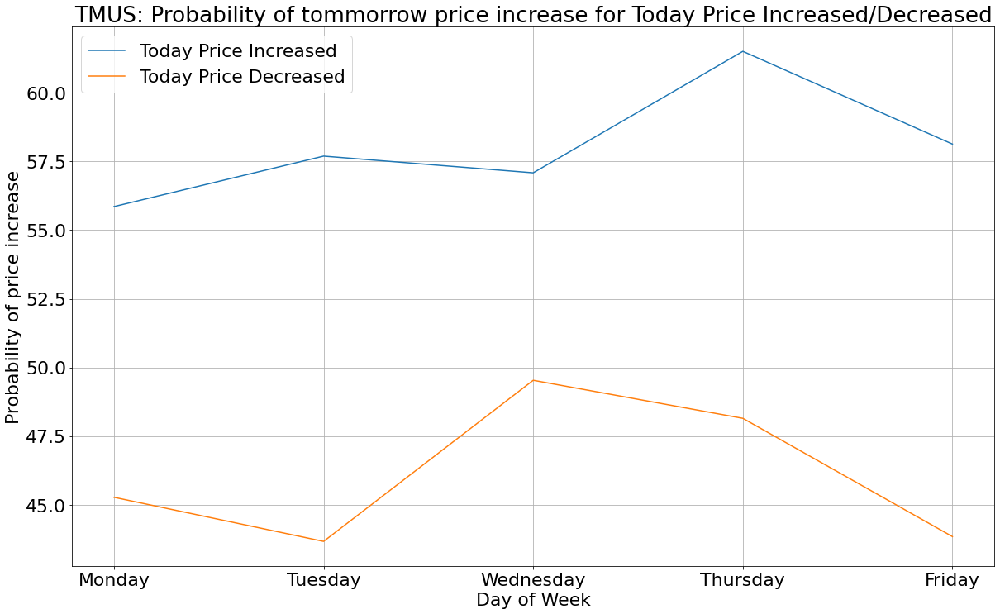

In [28]:
stock_yp_list=[i+'_Yesterday_Price_Change' for i in Stock]
stock_dc_list=[i+'_Daily_Change' for i in Stock]
stock_tmr_list=[i+'_tmr_Change' for i in Stock]

for i in range(len(stock_yp_list)):
    ax=(df[df[stock_yp_list[i]]==1].groupby('DayOfWeek')[[stock_dc_list[i]]].mean()*100).plot()
    (df[df[stock_yp_list[i]]==0].groupby('DayOfWeek')[[stock_dc_list[i]]].mean()*100).plot(ax=ax)
    plt.legend(bbox_to_anchor=(1.1, 1.05))
    plt.legend(['Yesterday Price Increased','Yesterday Price Decreased'])
    plt.xlabel("Day of Week")
    plt.ylabel("Probability of price increase")
    plt.xticks([1,2,3,4,5],['Monday','Tuesday','Wednesday','Thursday','Friday'],rotation=0)
    plt.title("{}: Probability of today price increase for Yesterday Price Increased/Decreased".format(Stock[i]))
    plt.grid()
    plt.savefig("{}_Probability of today price increase for Yesterday Price Increased_Decreased".format(Stock[i]), bbox_inches='tight')
    plt.show()

    ax=(df[df[stock_dc_list[i]]==1].groupby('DayOfWeek')[[stock_tmr_list[i]]].mean()*100).plot()
    (df[df[stock_dc_list[i]]==0].groupby('DayOfWeek')[[stock_tmr_list[i]]].mean()*100).plot(ax=ax)
    plt.legend(bbox_to_anchor=(1.1, 1.05))
    plt.legend(['Today Price Increased','Today Price Decreased'])
    plt.xlabel("Day of Week")
    plt.ylabel("Probability of price increase")
    plt.xticks([1,2,3,4,5],['Monday','Tuesday','Wednesday','Thursday','Friday'],rotation=0)
    plt.title("{}: Probability of tommorrow price increase for Today Price Increased/Decreased".format(Stock[i]))
    plt.grid()
    plt.savefig("{}_Probability of tommorrow price increase for Today Price Increased_Decreased".format(Stock[i]), bbox_inches='tight')
    plt.show()

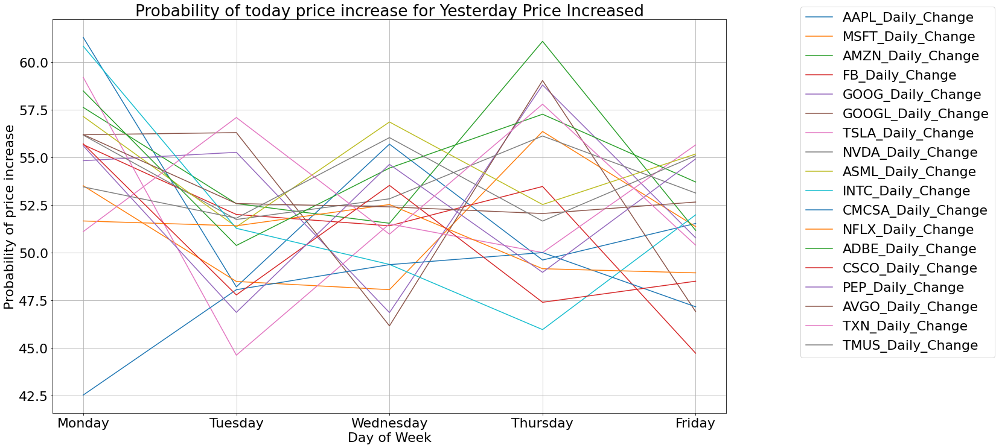

In [29]:
df_dayofweek=pd.DataFrame()
for i in range(len(stock_yp_list)):
    df_dayofweek=pd.concat([df_dayofweek,(df[df[stock_yp_list[i]]==1].groupby('DayOfWeek')[[stock_dc_list[i]]].mean()*100)], axis=1)
df_dayofweek.plot()
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.xlabel("Day of Week")
plt.ylabel("Probability of price increase")
plt.xticks([1,2,3,4,5],['Monday','Tuesday','Wednesday','Thursday','Friday'],rotation=0)
plt.title("Probability of today price increase for Yesterday Price Increased")
plt.grid()
plt.savefig("Probability of today price increase for Yesterday Price Increased", bbox_inches='tight')
plt.show()

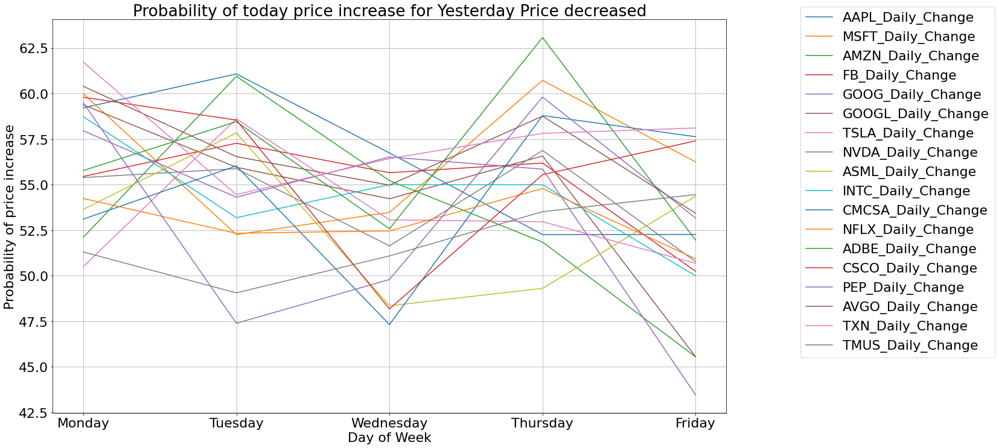

In [30]:
df_dayofweek=pd.DataFrame()
for i in range(len(stock_yp_list)):
    df_dayofweek=pd.concat([df_dayofweek,(df[df[stock_yp_list[i]]==0].groupby('DayOfWeek')[[stock_dc_list[i]]].mean()*100)], axis=1)
df_dayofweek.plot()
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.xlabel("Day of Week")
plt.ylabel("Probability of price increase")
plt.xticks([1,2,3,4,5],['Monday','Tuesday','Wednesday','Thursday','Friday'],rotation=0)
plt.title("Probability of today price increase for Yesterday Price decreased")
plt.grid()
plt.savefig("Probability of today price increase for Yesterday Price decreased", bbox_inches='tight')
plt.show()

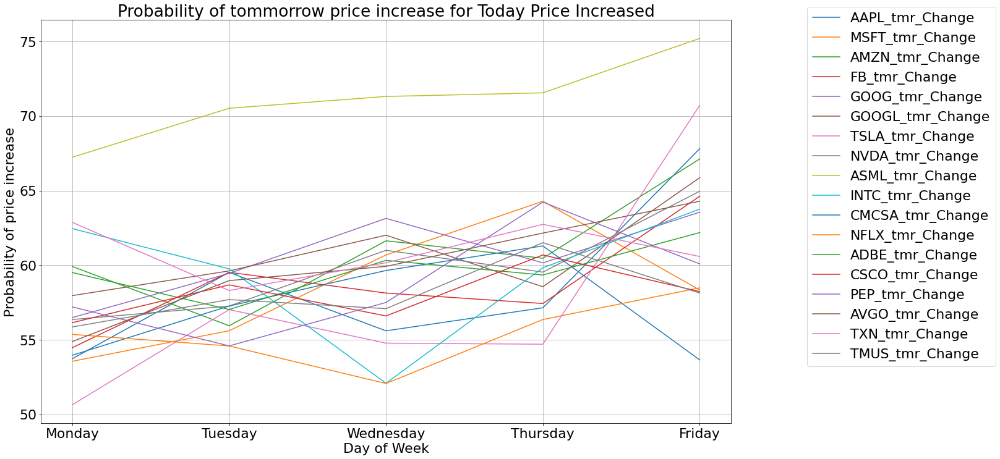

In [31]:
df_dayofweek=pd.DataFrame()
for i in range(len(stock_yp_list)):
    df_dayofweek=pd.concat([df_dayofweek,(df[df[stock_dc_list[i]]==1].groupby('DayOfWeek')[[stock_tmr_list[i]]].mean()*100)], axis=1)
df_dayofweek.plot()
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.xlabel("Day of Week")
plt.ylabel("Probability of price increase")
plt.xticks([1,2,3,4,5],['Monday','Tuesday','Wednesday','Thursday','Friday'],rotation=0)
plt.title("Probability of tommorrow price increase for Today Price Increased")
plt.grid()
plt.savefig("Probability of tommorrow price increase for Today Price Increased", bbox_inches='tight')
plt.show()

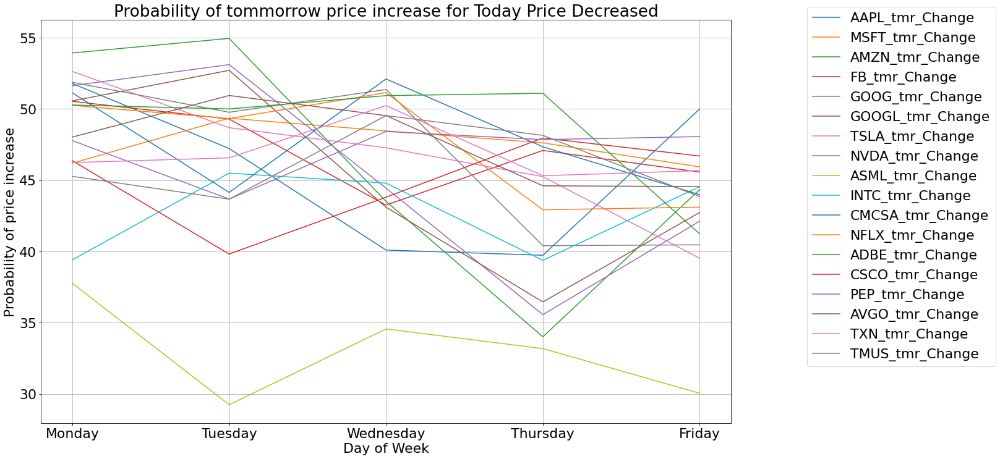

In [32]:
df_dayofweek=pd.DataFrame()
for i in range(len(stock_yp_list)):
    df_dayofweek=pd.concat([df_dayofweek,(df[df[stock_dc_list[i]]==0].groupby('DayOfWeek')[[stock_tmr_list[i]]].mean()*100)], axis=1)
df_dayofweek.plot()
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.xlabel("Day of Week")
plt.ylabel("Probability of price increase")
plt.xticks([1,2,3,4,5],['Monday','Tuesday','Wednesday','Thursday','Friday'],rotation=0)
plt.title("Probability of tommorrow price increase for Today Price Decreased")
plt.grid()
plt.savefig("Probability of tommorrow price increase for Today Price Decreased", bbox_inches='tight')
plt.show()

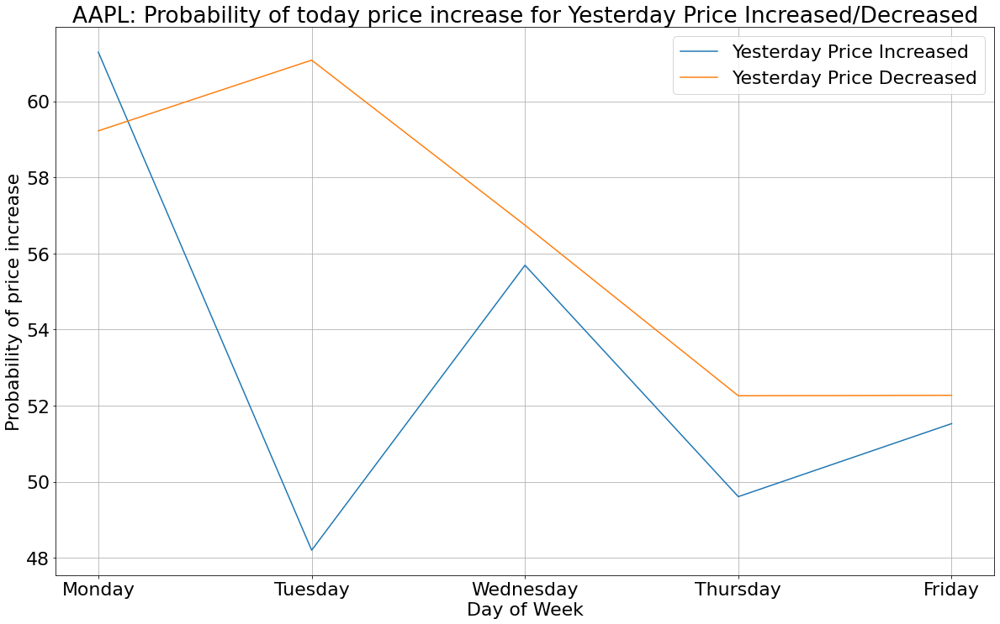

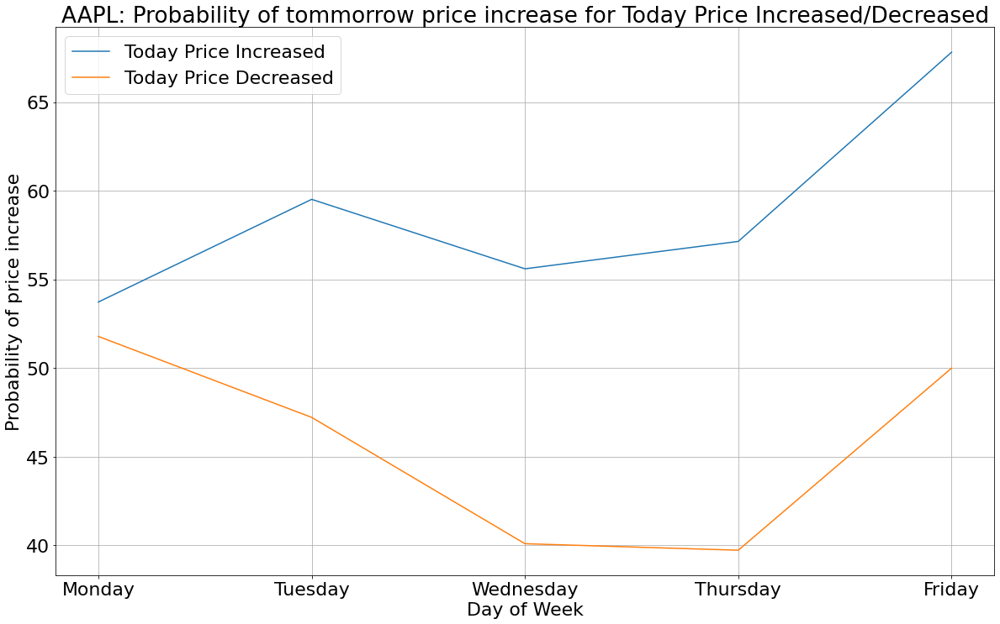

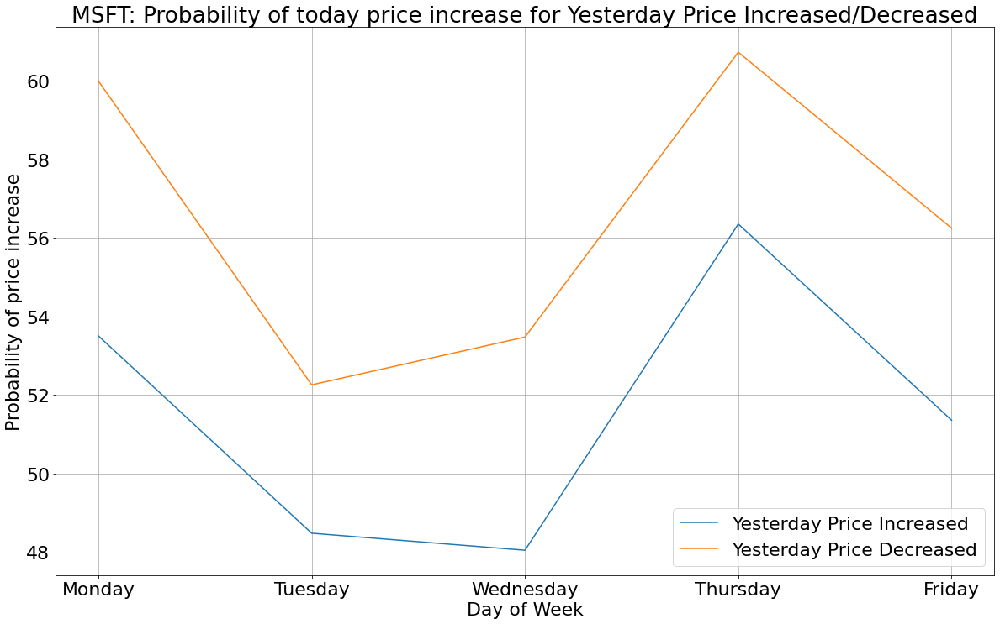

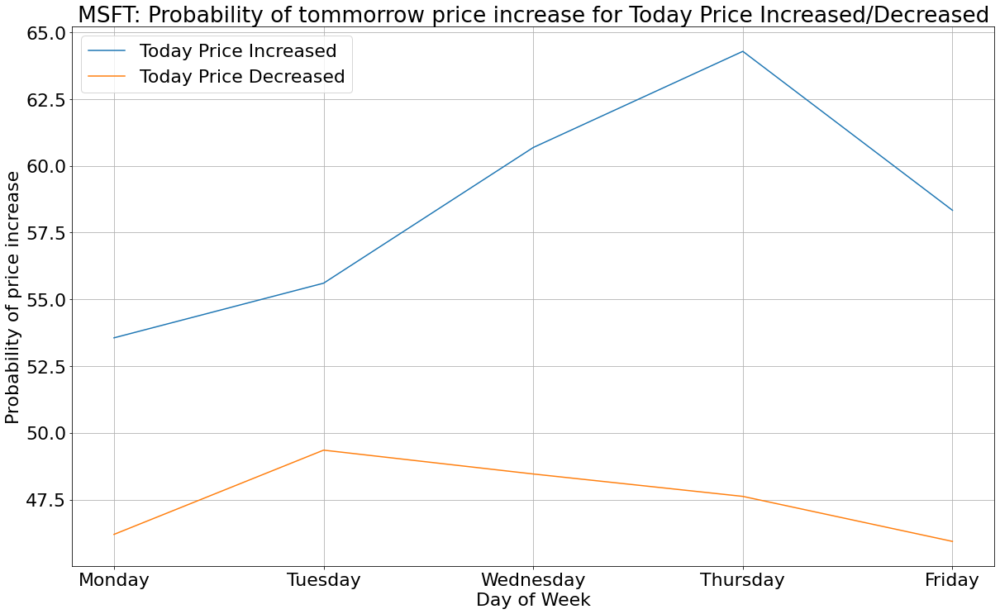

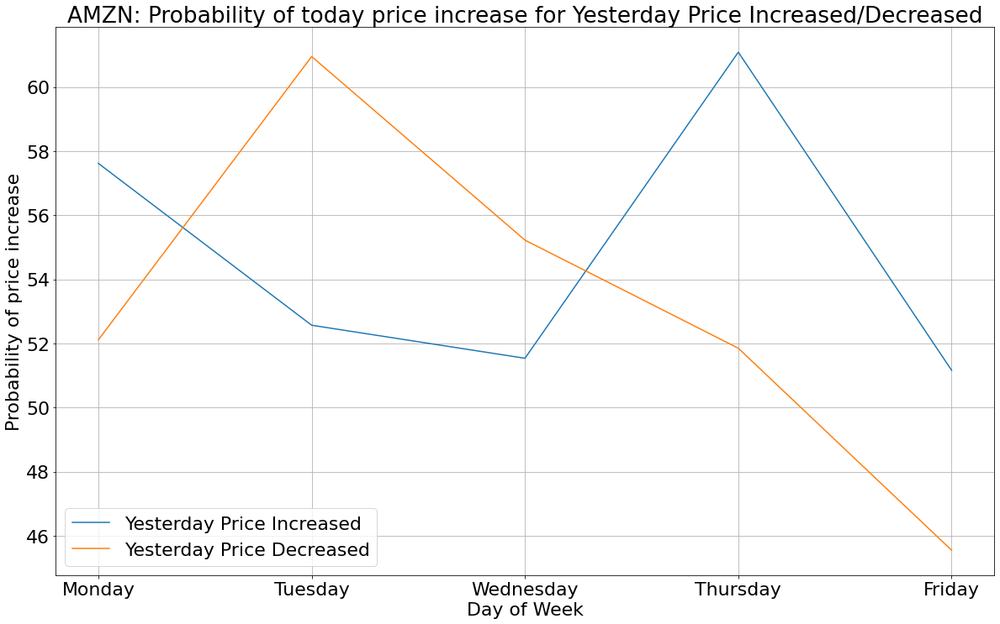

...

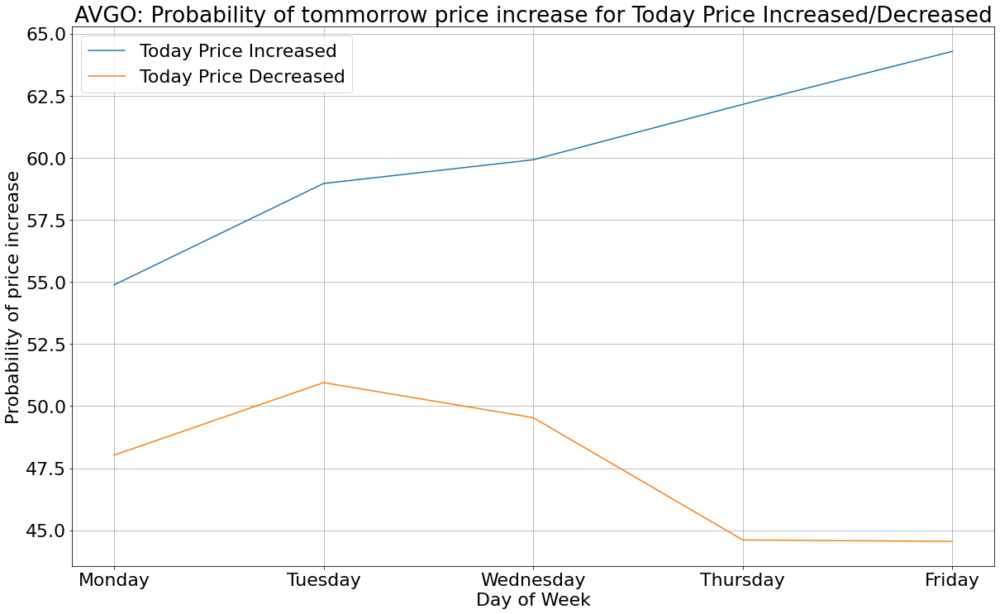

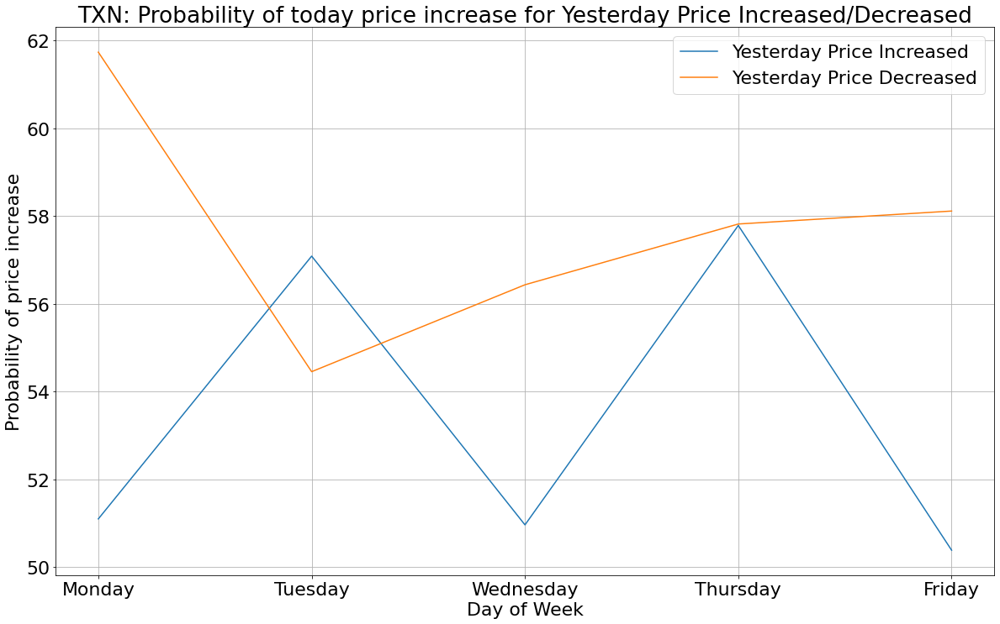

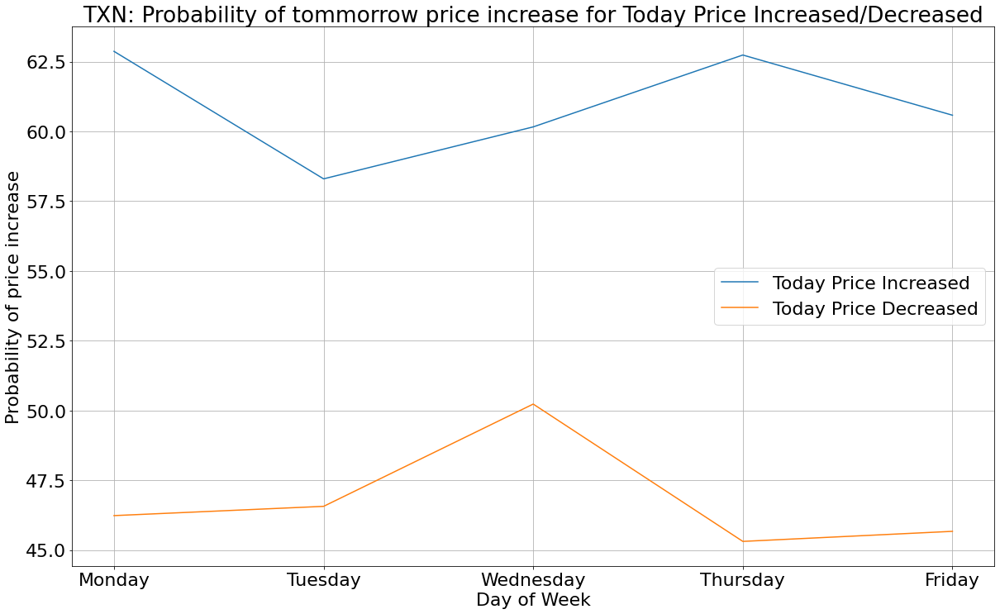

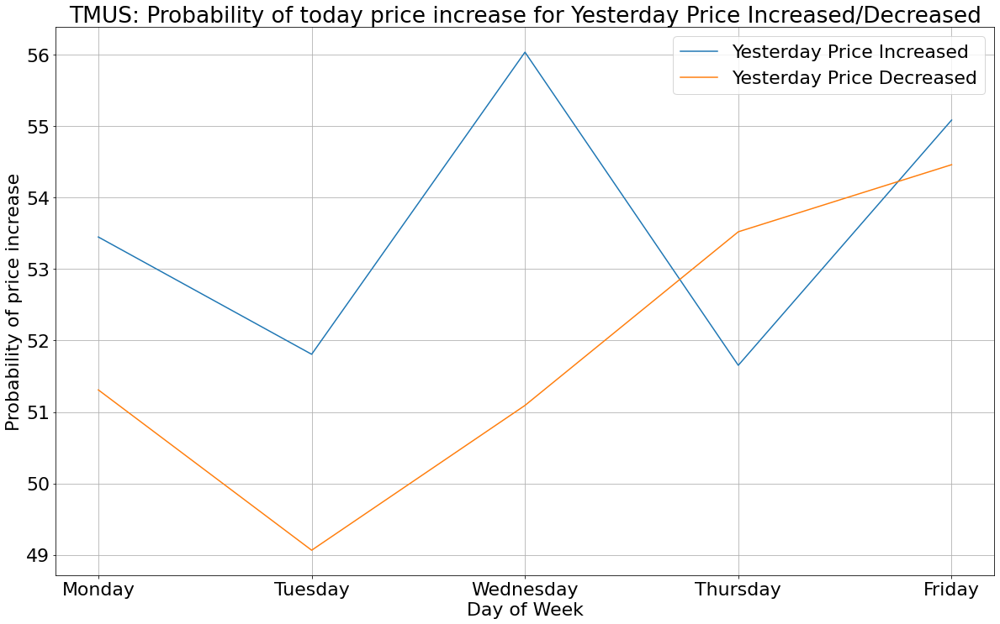

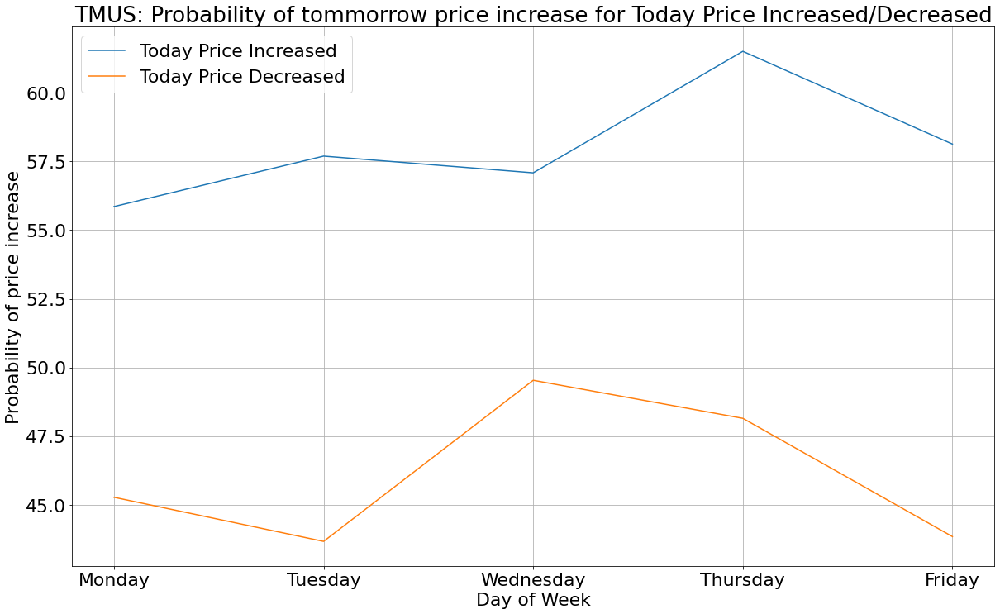

In [33]:
for i in range(len(stock_yp_list)):
    ax=(df[df[stock_yp_list[i]]==1].groupby('DayOfWeek')[[stock_dc_list[i]]].mean()*100).plot()
    (df[df[stock_yp_list[i]]==0].groupby('DayOfWeek')[[stock_dc_list[i]]].mean()*100).plot(ax=ax)
    plt.legend(bbox_to_anchor=(1.1, 1.05))
    plt.legend(['Yesterday Price Increased','Yesterday Price Decreased'])
    plt.xlabel("Day of Week")
    plt.ylabel("Probability of price increase")
    plt.xticks([1,2,3,4,5],['Monday','Tuesday','Wednesday','Thursday','Friday'],rotation=0)
    plt.title("{}: Probability of today price increase for Yesterday Price Increased/Decreased".format(Stock[i]))
    plt.grid()
    plt.savefig("{}_Probability of today price increase for Yesterday Price Increased_Decreased".format(Stock[i]), bbox_inches='tight')
    plt.show()

    ax=(df[df[stock_dc_list[i]]==1].groupby('DayOfWeek')[[stock_tmr_list[i]]].mean()*100).plot()
    (df[df[stock_dc_list[i]]==0].groupby('DayOfWeek')[[stock_tmr_list[i]]].mean()*100).plot(ax=ax)
    plt.legend(bbox_to_anchor=(1.1, 1.05))
    plt.legend(['Today Price Increased','Today Price Decreased'])
    plt.xlabel("Day of Week")
    plt.ylabel("Probability of price increase")
    plt.xticks([1,2,3,4,5],['Monday','Tuesday','Wednesday','Thursday','Friday'],rotation=0)
    plt.title("{}: Probability of tommorrow price increase for Today Price Increased/Decreased".format(Stock[i]))
    plt.grid()
    plt.savefig("{}_Probability of tommorrow price increase for Today Price Increased_Decreased".format(Stock[i]), bbox_inches='tight')
    plt.show()